## Import Module/Library

In [1]:
import os
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Model

## Config Parameters

In [3]:
375/32

11.71875

In [4]:
1242/32

38.8125

In [5]:
BATCH_SIZE = 8
# IMG_HEGIHT  = 375
# IMG_WIDHT   = 1242
IMG_HEGIHT  = 11*32
IMG_WIDHT   = 38*32
IMG_CHANNEL = 3
BUFFER_SIZE = BATCH_SIZE*10

IMG_CHANNEL = 3
TRAIN_PATH = "Stereo/data_scene_flow/training"
LEFT_DIR = 'image_2'
RIGHT_DIR = 'image_3'
DISP_DIR = 'disp_noc_0_stixel2'
SPARE = 'disp_noc_0'

## Compare Dense 

In [6]:
def load_comapre(spare_path, dense_path):
    
    spare   = tf.io.read_file(spare_path)
    spare   = tf.image.decode_png(spare, dtype=tf.uint16, channels=1)
    
    dense   = tf.io.read_file(dense_path)
    dense   = tf.image.decode_png(dense, dtype=tf.uint16, channels=1)
    
    spare  = tf.image.resize(spare, (IMG_HEGIHT, IMG_WIDHT))
    dense = tf.image.resize(dense, (IMG_HEGIHT, IMG_WIDHT))

    # Convert both images to float32 tensors
    spare = tf.cast(spare, tf.float32)/256.0
    dense = tf.cast(dense, tf.float32)/256.0
    
    return spare, dense

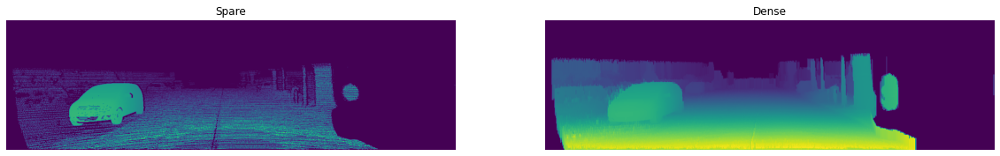

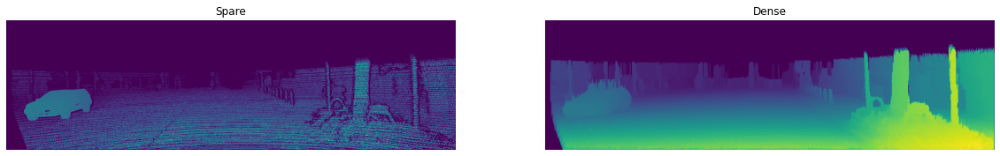

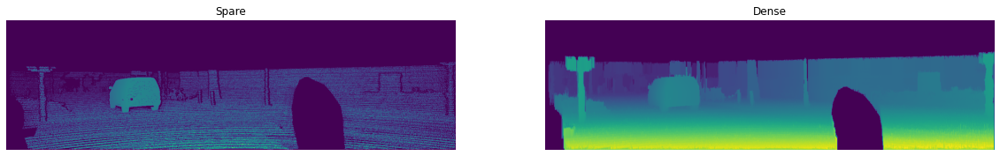

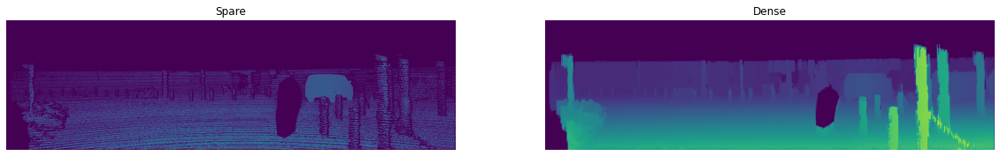

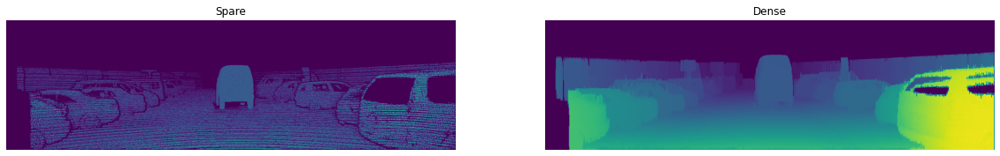

...

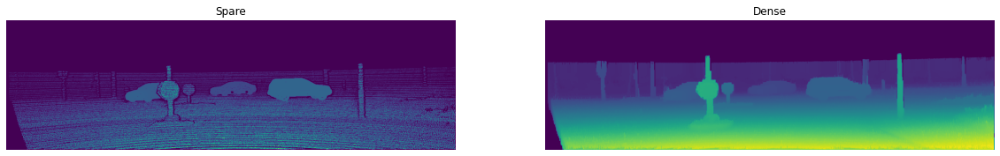

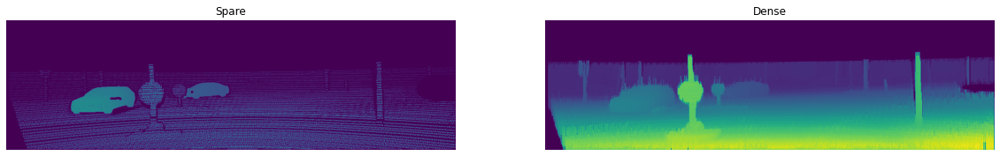

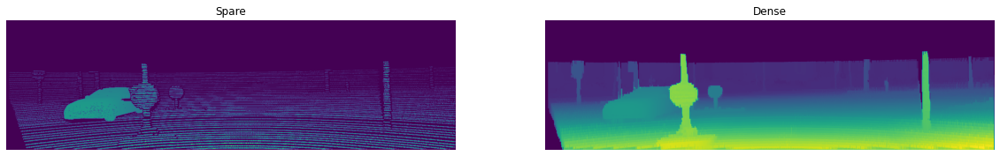

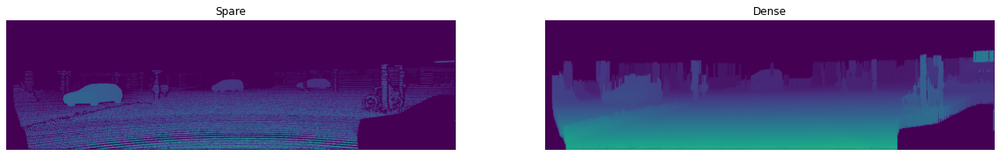

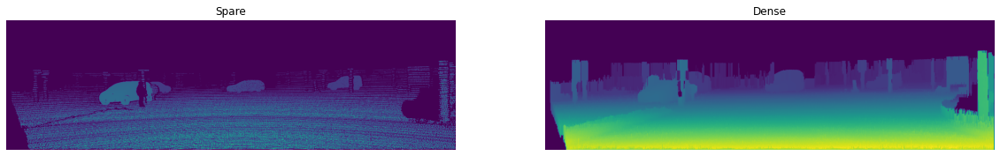

In [7]:
for idx in range(15):
    name__ = f'{idx:06d}_10.png'

    spare, dense = load_comapre(os.path.join(TRAIN_PATH, SPARE, name__),
                        os.path.join(TRAIN_PATH, DISP_DIR, name__))
    plt.figure(figsize=(20,20))
    display_list = [spare, dense]


    title = ['Spare', 'Dense']    

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    plt.show()       

##  Load Data

In [8]:
def load(left_image_path, right_image_path, ground_truth_path):
    
    left_image   = tf.io.read_file(left_image_path)
    left_image   = tf.image.decode_png(left_image,channels=IMG_CHANNEL)
    
    right_image   = tf.io.read_file(right_image_path)
    right_image   = tf.image.decode_png(right_image,channels=IMG_CHANNEL)
    
    ground_truth   = tf.io.read_file(ground_truth_path)
    ground_truth   = tf.image.decode_png(ground_truth, dtype=tf.uint16, channels=1)
    
    left_image  = tf.image.resize(left_image, (IMG_HEGIHT, IMG_WIDHT))
    right_image = tf.image.resize(right_image, (IMG_HEGIHT, IMG_WIDHT))
    ground_truth = tf.image.resize(ground_truth, (IMG_HEGIHT, IMG_WIDHT))
    # Convert both images to float32 tensors
    left_image  = tf.cast(left_image, tf.float32)
    right_image = tf.cast(right_image, tf.float32)
    ground_truth = tf.cast(ground_truth, tf.float32)/256.0
    
    return left_image, right_image, ground_truth

(352, 1216, 3)
(352, 1216, 3)
(352, 1216, 1)


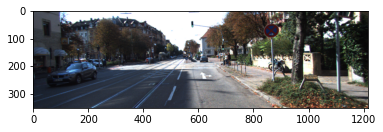

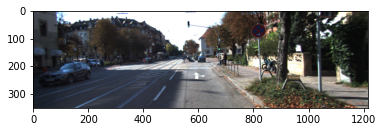

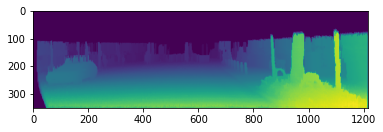

In [9]:
num__ = 1
name__ = f'{num__:06d}_10.png'
left_image, right_image, ground_truth = load(
                                        os.path.join(TRAIN_PATH, LEFT_DIR, name__),
                                        os.path.join(TRAIN_PATH, RIGHT_DIR, name__),
                                        os.path.join(TRAIN_PATH, DISP_DIR, name__))
print(left_image.shape)
print(right_image.shape)
print(ground_truth.shape)


# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(left_image/255.0)
plt.figure()
plt.imshow(right_image/255.0)
plt.figure()
plt.imshow(ground_truth/255.0)

In [10]:
ground_truth.numpy().max()

78.47406

In [11]:
@tf.function()
def random_flip(left_image, right_image, ground_truth):
    if tf.random.uniform(()) > 0.5:
        # Random mirroring
        left_image  = tf.image.flip_left_right(left_image)
        right_image = tf.image.flip_left_right(right_image)
        ground_truth = tf.image.flip_left_right(ground_truth)

    return left_image, right_image, ground_truth


def processing_image(left_image, right_image, ground_truth):
#     input_image = tf.keras.applications.resnet50.preprocess_input(input_image)
# #     target_image = tf.keras.applications.resnet50.preprocess_input(target_image)
    
    left_image  = (left_image / 255.0) 
    right_image = (right_image / 255.0)
    return left_image, right_image, ground_truth


def load_image_train(left_image_path, right_image_path, ground_truth_path):
    left_image, right_image, ground_truth = load(left_image_path, right_image_path, ground_truth_path)
    left_image, right_image, ground_truth = random_flip(left_image, right_image, ground_truth)
    left_image, right_image, ground_truth = processing_image(left_image, right_image, ground_truth)

    return left_image, right_image, ground_truth


def load_image_val(left_image_path, right_image_path, ground_truth_path):
    left_image, right_image, ground_truth = load(left_image_path, right_image_path, ground_truth_path)
    left_image, right_image, ground_truth = processing_image(left_image, right_image, ground_truth)

    return left_image, right_image, ground_truth

In [12]:
val_img_list = [1,3,6,20,26,35,38,41,43,44,49,60,67,70,81,84,89,97,109,119,122,123,129,130,132,134,141,144,152,158,159,165,171,174,179,182, 184,186,187,196]

In [13]:
def get_path_imgs(img_names):
    left_image_path = []
    right_image_path = []
    ground_truth_path = []
    for im_n in img_names:
        left_image_path.append(os.path.join(TRAIN_PATH, LEFT_DIR, im_n))
        right_image_path.append(os.path.join(TRAIN_PATH, RIGHT_DIR, im_n))
        ground_truth_path.append(os.path.join(TRAIN_PATH, DISP_DIR, im_n))

    return left_image_path, right_image_path, ground_truth_path


def get_train_val_img_names():
    img_names = [im_n for im_n in os.listdir(os.path.join(TRAIN_PATH, LEFT_DIR)) if im_n.find('_10') > -1]
    assert len(img_names) == 200
    train_img_names = [img_names[i] for i in range(len(img_names)) if i not in val_img_list]
    val_img_names = [img_names[i] for i in val_img_list]
    
    train_imgs_path = get_path_imgs(train_img_names)
    val_imgs_path = get_path_imgs(val_img_names)
    
    return train_imgs_path, val_imgs_path

In [14]:

train_imgs_path, val_imgs_path = get_train_val_img_names()

In [15]:
train_dataset = tf.data.Dataset.from_tensor_slices((train_imgs_path[0],train_imgs_path[1],train_imgs_path[2]))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)


In [16]:
val_dataset = tf.data.Dataset.from_tensor_slices((val_imgs_path[0],val_imgs_path[1],val_imgs_path[2]))
val_dataset = val_dataset.map(load_image_val)
val_dataset = val_dataset.batch(BATCH_SIZE)

## Build Model 

In [17]:
class BuildRes50Unet():
    def __init__(self):
        
        self.encoder_blocks_name = ["conv1_relu", "conv2_block3_out", "conv3_block4_out",
                                    "conv4_block6_out"]
        self.bridge_block_name = "conv5_block3_out"
#         self.encoder_blocks_name = ["input_1", "conv1_relu", "conv2_block3_out", "conv3_block4_out"]
#         self.bridge_block_name = "conv4_block6_out"
    
    def conv_block(self, inputs, num_filters):
        x = layers.Conv2D(filters=num_filters, kernel_size=(3,3), padding="same")(inputs)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        
        x = layers.Conv2D(filters=num_filters, kernel_size=(3,3), padding="same")(x)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU()(x)
        
        return x
    
    
    def upsample_concate_block(self, inputs, skip_connection, num_filters):
        x = layers.Conv2DTranspose(filters=num_filters, kernel_size=(2,2), strides=2, padding='same')(inputs)
        x = layers.Concatenate()([skip_connection, x])
        x = self.conv_block(x, num_filters)
        
        return x
    
    
    def build_model(self, input_shape):
        l_inputs = layers.Input(shape=input_shape)
        r_inputs = layers.Input(shape=input_shape)
        inputs = layers.Concatenate( axis=-1)([l_inputs, r_inputs])
        
        # encoder
        backbone = tf.keras.applications.ResNet50(include_top=False, input_tensor=inputs,
                                                  weights=None)
        eb0 = backbone.get_layer(name=self.encoder_blocks_name[0]).output
        eb1 = backbone.get_layer(name=self.encoder_blocks_name[1]).output
        eb2 = backbone.get_layer(name=self.encoder_blocks_name[2]).output
        eb3 = backbone.get_layer(name=self.encoder_blocks_name[3]).output
        
        # bridge
        br = backbone.get_layer(name=self.bridge_block_name).output
        
        # decoder
        db3 = self.upsample_concate_block(inputs=br, skip_connection=eb3, num_filters=512)
        db2 = self.upsample_concate_block(inputs=db3, skip_connection=eb2, num_filters=256)
        db1 = self.upsample_concate_block(inputs=db2, skip_connection=eb1, num_filters=128)
        db0 = self.upsample_concate_block(inputs=db1, skip_connection=eb0, num_filters=64)
        
        # final output
        first_feature = layers.Conv2D(filters=64, kernel_size=(3,3), padding='same')(inputs)
        final_feature = self.upsample_concate_block(inputs=db0, skip_connection=first_feature, num_filters=64)
#         outputs = layers.Conv2D(filters=1, kernel_size=(1,1), activation='sigmoid')(final_feature)
        outputs = layers.Conv2D(filters=1, kernel_size=(1,1), activation='relu')(final_feature)
        
        model = Model(inputs=[l_inputs,r_inputs], outputs=outputs)
        
        return  model

In [18]:
model = BuildRes50Unet()
res50Unet = model.build_model(input_shape=(IMG_HEGIHT, IMG_WIDHT, IMG_CHANNEL))

## Config and Compile Model

### Show Generated Images and Evaluation Function

In [19]:
def evaluate(model, epoch, dataset):  
    psnr_mean = 0.0
    count = 0
    for l_inputs, r_inputs, targets in dataset:
        fake = model([l_inputs, r_inputs], training=False)
        masks = targets > 0 

        psnr = tf.image.psnr(tf.where(masks,fake,0)/255.0, tf.where(masks,targets,0)/255.0, max_val=1.0)

        __psnr_mean = tf.math.reduce_mean(psnr)
        # psnr_mean = psnr_mean_l
        
        psnr_mean += __psnr_mean
        count =count + 1
    
    psnr_mean = psnr_mean/count
    print('-------- psnr: ', psnr_mean.numpy(), '   ----- epoch: ', epoch, '  count: ', count)
    
    return psnr_mean
    

def generate_images(model, l_inputs, r_inputs, targets):
    fake = model([l_inputs, r_inputs], training=False)
    plt.figure(figsize=(15,20))
    
    display_list = [l_inputs[0], r_inputs[0], targets[0], fake[0]]
    
    
    title = ['LInput', 'RInput', 'Real', 'Predicted']    

    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    plt.show()       

### Loss

In [20]:
def generator_loss(fake, target, loss_type='L1'):
    loss_list = ["L1"]
    assert loss_type in loss_list
    # L1
    if loss_type == loss_list[0]:
        masks =  target > 0
        loss = tf.reduce_mean(tf.abs(fake[masks]-target[masks]))*30
    return loss

### Optimizer

In [21]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

## Training

In [22]:

@tf.function
def train_step(l_inputs, r_inputs, targets):
    with tf.GradientTape() as tape:
        # output
        fake = res50Unet([l_inputs, r_inputs], training=True)     
        loss = generator_loss(fake, targets, loss_type='L1')

    generator_gradients = tape.gradient(loss, res50Unet.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, res50Unet.trainable_variables))
    
    return loss

    
    
def fit(train_ds, epochs, val_ds):
    best_pnsr = 0.0
    step_counter = 0
    for epoch in range(epochs):
        # Train
        total_loss = 0.0
        for l_inputs, r_inputs, targets in train_ds:
            loss = train_step(l_inputs, r_inputs, targets)
            total_loss = total_loss + loss
            step_counter += 1
        total_loss = total_loss/step_counter
        print('epoch: {}   loss: {}'.format(epoch, total_loss))
        
        pnsr = evaluate(res50Unet, epoch, val_ds)        
        if best_pnsr < pnsr or True:
            best_pnsr = pnsr
            
            for l_inputs, r_inputs, targets in val_ds.take(1):
                generate_images(res50Unet, l_inputs, r_inputs, targets)


2022-03-17 23:02:26.263881: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8100


epoch: 0   loss: 950.8345947265625


2022-03-17 23:02:42.221035: I tensorflow/stream_executor/cuda/cuda_blas.cc:1786] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


-------- psnr:  18.62247    ----- epoch:  0   count:  5


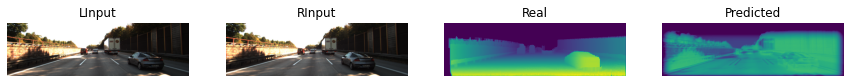

epoch: 1   loss: 444.42938232421875
-------- psnr:  19.621496    ----- epoch:  1   count:  5


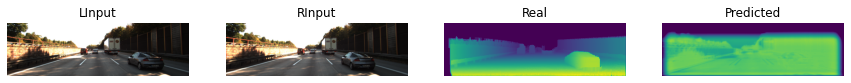

epoch: 2   loss: 290.9093017578125
-------- psnr:  19.99477    ----- epoch:  2   count:  5


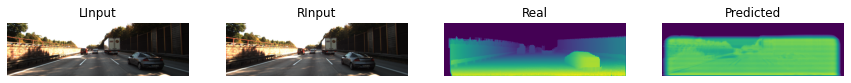

epoch: 3   loss: 216.68002319335938
-------- psnr:  20.554228    ----- epoch:  3   count:  5


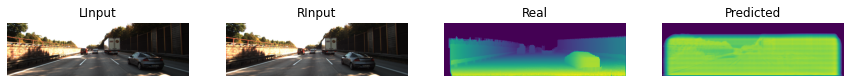

epoch: 4   loss: 172.5728302001953
-------- psnr:  20.35284    ----- epoch:  4   count:  5


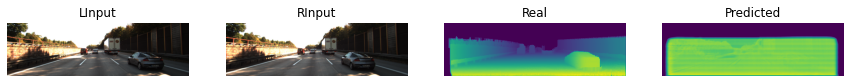

epoch: 5   loss: 143.21713256835938
-------- psnr:  20.656841    ----- epoch:  5   count:  5


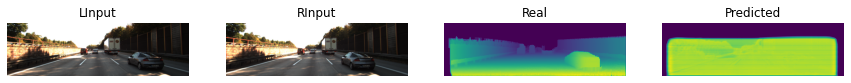

epoch: 6   loss: 122.27424621582031
-------- psnr:  20.433167    ----- epoch:  6   count:  5


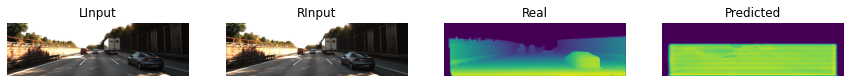

epoch: 7   loss: 106.62032318115234
-------- psnr:  20.646524    ----- epoch:  7   count:  5


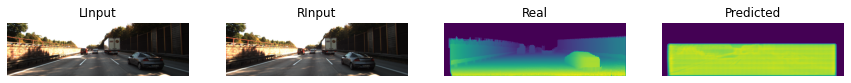

epoch: 8   loss: 94.39293670654297
-------- psnr:  20.26337    ----- epoch:  8   count:  5


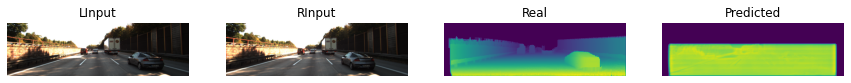

epoch: 9   loss: 84.69807434082031
-------- psnr:  20.127054    ----- epoch:  9   count:  5


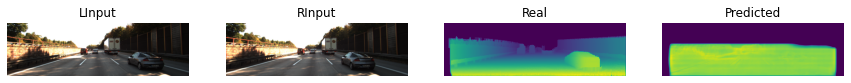

epoch: 10   loss: 76.72896575927734
-------- psnr:  20.222378    ----- epoch:  10   count:  5


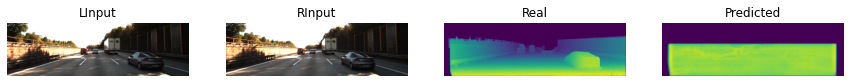

epoch: 11   loss: 70.09008026123047
-------- psnr:  20.198078    ----- epoch:  11   count:  5


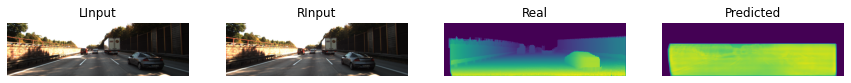

epoch: 12   loss: 64.47750854492188
-------- psnr:  20.124828    ----- epoch:  12   count:  5


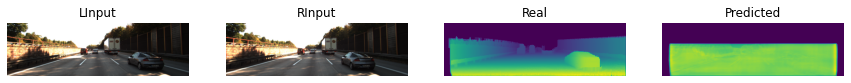

epoch: 13   loss: 59.67863464355469
-------- psnr:  20.104462    ----- epoch:  13   count:  5


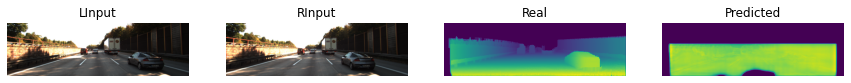

epoch: 14   loss: 55.5263786315918
-------- psnr:  20.313831    ----- epoch:  14   count:  5


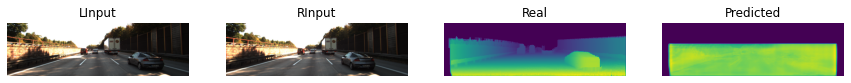

epoch: 15   loss: 51.85886764526367
-------- psnr:  20.160007    ----- epoch:  15   count:  5


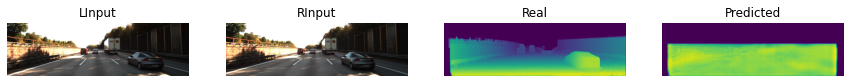

epoch: 16   loss: 48.64181900024414
-------- psnr:  20.248627    ----- epoch:  16   count:  5


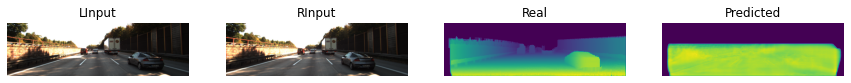

epoch: 17   loss: 45.79218673706055
-------- psnr:  20.584568    ----- epoch:  17   count:  5


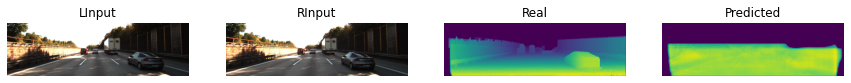

epoch: 18   loss: 43.204383850097656
-------- psnr:  20.647507    ----- epoch:  18   count:  5


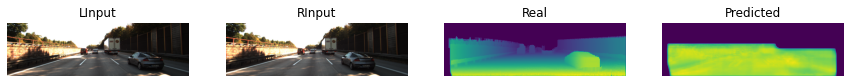

epoch: 19   loss: 40.90902328491211
-------- psnr:  20.498959    ----- epoch:  19   count:  5


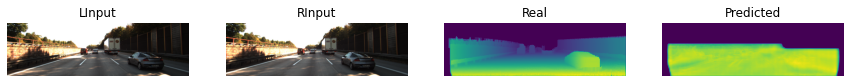

epoch: 20   loss: 38.80496597290039
-------- psnr:  20.475283    ----- epoch:  20   count:  5


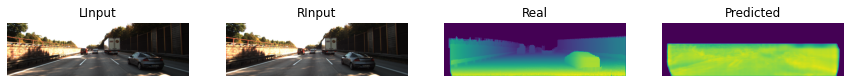

epoch: 21   loss: 36.892616271972656
-------- psnr:  20.306177    ----- epoch:  21   count:  5


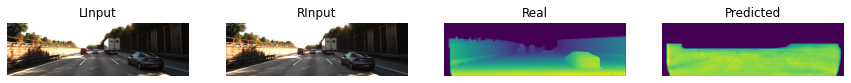

epoch: 22   loss: 35.16685485839844
-------- psnr:  20.38514    ----- epoch:  22   count:  5


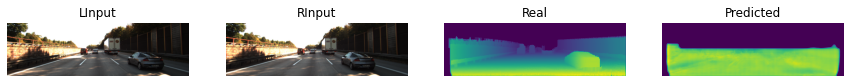

epoch: 23   loss: 33.582698822021484
-------- psnr:  20.562279    ----- epoch:  23   count:  5


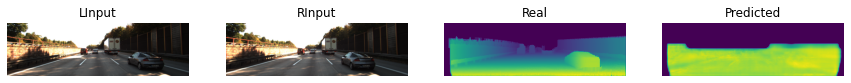

epoch: 24   loss: 32.107479095458984
-------- psnr:  20.607998    ----- epoch:  24   count:  5


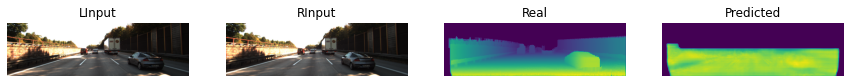

epoch: 25   loss: 30.755176544189453
-------- psnr:  20.52736    ----- epoch:  25   count:  5


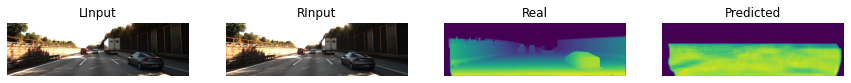

epoch: 26   loss: 29.4965877532959
-------- psnr:  20.571613    ----- epoch:  26   count:  5


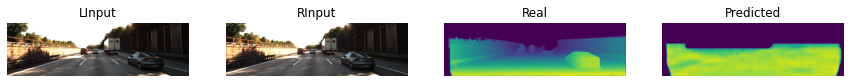

epoch: 27   loss: 28.346181869506836
-------- psnr:  20.548622    ----- epoch:  27   count:  5


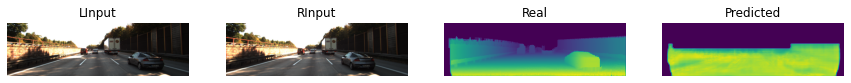

epoch: 28   loss: 27.24152374267578
-------- psnr:  20.575336    ----- epoch:  28   count:  5


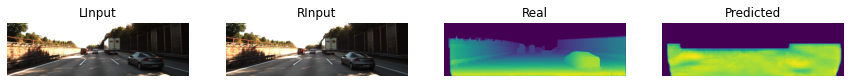

epoch: 29   loss: 26.282968521118164
-------- psnr:  18.656729    ----- epoch:  29   count:  5


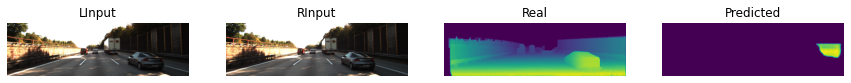

epoch: 30   loss: 25.307395935058594
-------- psnr:  20.298567    ----- epoch:  30   count:  5


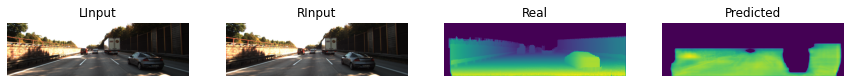

epoch: 31   loss: 24.408855438232422
-------- psnr:  20.824675    ----- epoch:  31   count:  5


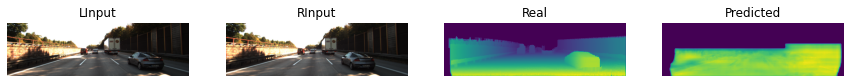

epoch: 32   loss: 23.566858291625977
-------- psnr:  20.410053    ----- epoch:  32   count:  5


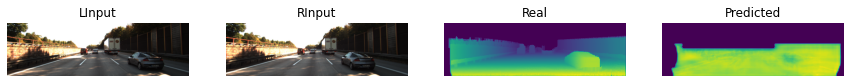

epoch: 33   loss: 22.777435302734375
-------- psnr:  20.928616    ----- epoch:  33   count:  5


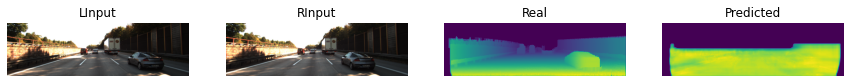

epoch: 34   loss: 22.02850341796875
-------- psnr:  20.873055    ----- epoch:  34   count:  5


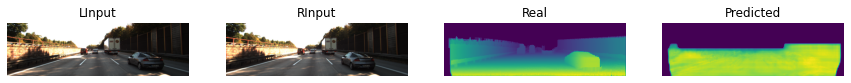

epoch: 35   loss: 21.315526962280273
-------- psnr:  20.53886    ----- epoch:  35   count:  5


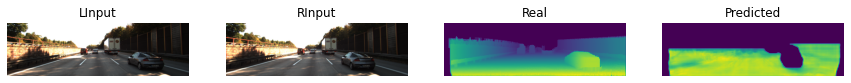

epoch: 36   loss: 20.65875244140625
-------- psnr:  21.011068    ----- epoch:  36   count:  5


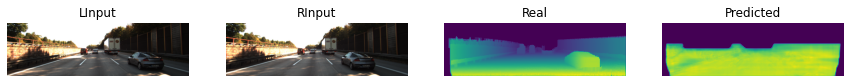

epoch: 37   loss: 20.023916244506836
-------- psnr:  21.143478    ----- epoch:  37   count:  5


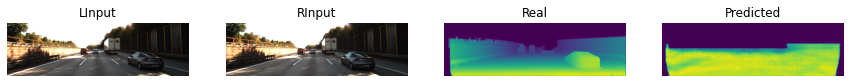

epoch: 38   loss: 19.42365074157715
-------- psnr:  21.04753    ----- epoch:  38   count:  5


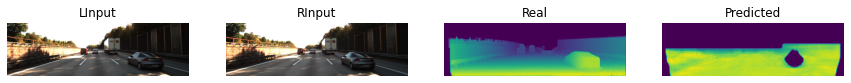

epoch: 39   loss: 18.862564086914062
-------- psnr:  21.241863    ----- epoch:  39   count:  5


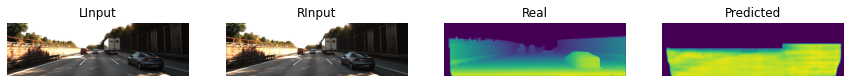

epoch: 40   loss: 18.321456909179688
-------- psnr:  21.015772    ----- epoch:  40   count:  5


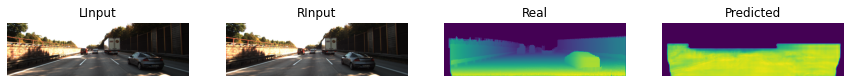

epoch: 41   loss: 17.802268981933594
-------- psnr:  21.205505    ----- epoch:  41   count:  5


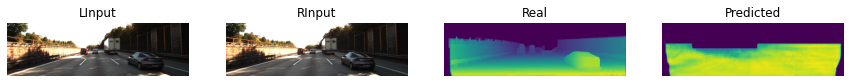

epoch: 42   loss: 17.31232261657715
-------- psnr:  21.305447    ----- epoch:  42   count:  5


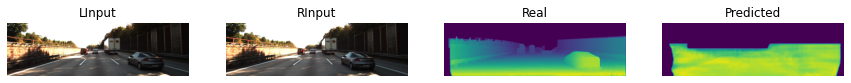

epoch: 43   loss: 16.83624267578125
-------- psnr:  21.201588    ----- epoch:  43   count:  5


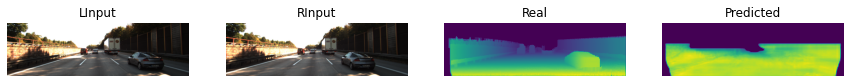

epoch: 44   loss: 16.387393951416016
-------- psnr:  21.12526    ----- epoch:  44   count:  5


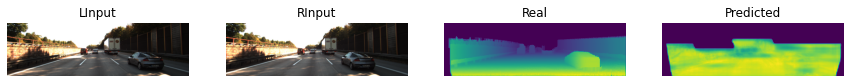

epoch: 45   loss: 15.953770637512207
-------- psnr:  21.192532    ----- epoch:  45   count:  5


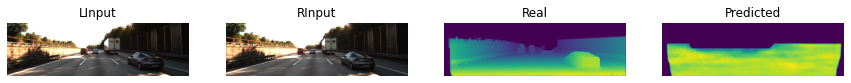

epoch: 46   loss: 15.537412643432617
-------- psnr:  21.489513    ----- epoch:  46   count:  5


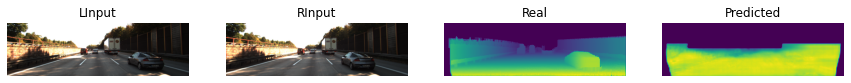

epoch: 47   loss: 15.14172077178955
-------- psnr:  21.208973    ----- epoch:  47   count:  5


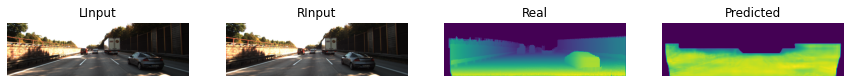

epoch: 48   loss: 14.752328872680664
-------- psnr:  21.490084    ----- epoch:  48   count:  5


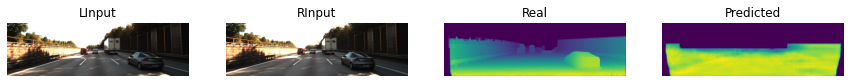

epoch: 49   loss: 14.388284683227539
-------- psnr:  21.470783    ----- epoch:  49   count:  5


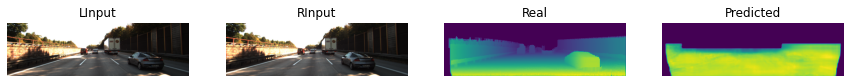

epoch: 50   loss: 14.023515701293945
-------- psnr:  21.543095    ----- epoch:  50   count:  5


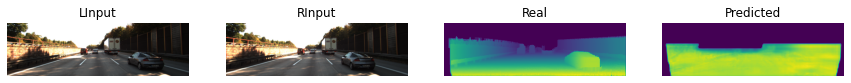

epoch: 51   loss: 13.693317413330078
-------- psnr:  21.513065    ----- epoch:  51   count:  5


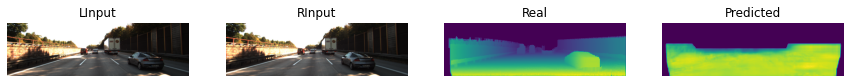

epoch: 52   loss: 13.3624906539917
-------- psnr:  21.580593    ----- epoch:  52   count:  5


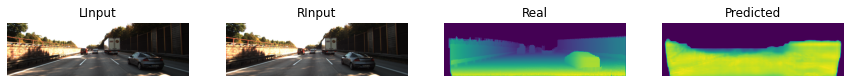

epoch: 53   loss: 13.042323112487793
-------- psnr:  21.570148    ----- epoch:  53   count:  5


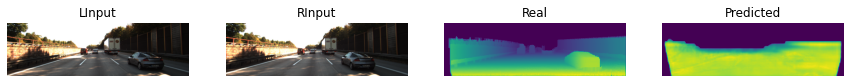

epoch: 54   loss: 12.735244750976562
-------- psnr:  21.608921    ----- epoch:  54   count:  5


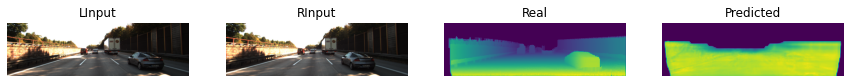

epoch: 55   loss: 12.435873985290527
-------- psnr:  21.405188    ----- epoch:  55   count:  5


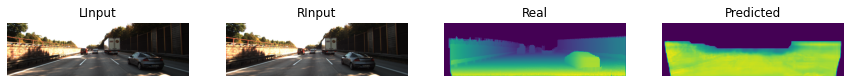

epoch: 56   loss: 12.154871940612793
-------- psnr:  21.473703    ----- epoch:  56   count:  5


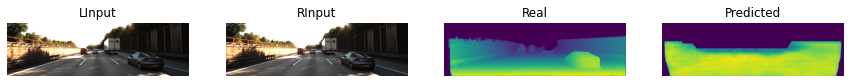

epoch: 57   loss: 11.881224632263184
-------- psnr:  21.407978    ----- epoch:  57   count:  5


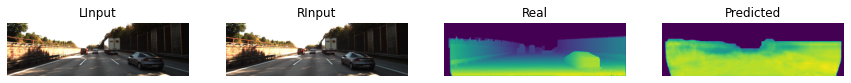

epoch: 58   loss: 11.61877155303955
-------- psnr:  21.749207    ----- epoch:  58   count:  5


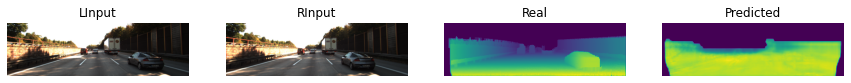

epoch: 59   loss: 11.363977432250977
-------- psnr:  21.575478    ----- epoch:  59   count:  5


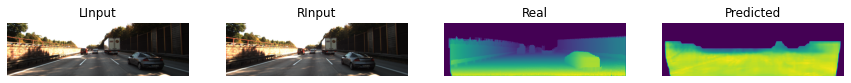

epoch: 60   loss: 11.106450080871582
-------- psnr:  21.80456    ----- epoch:  60   count:  5


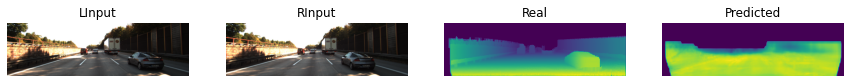

epoch: 61   loss: 10.871092796325684
-------- psnr:  21.729069    ----- epoch:  61   count:  5


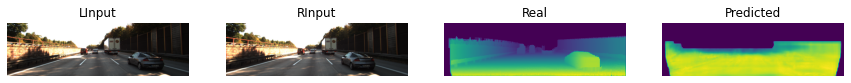

epoch: 62   loss: 10.639074325561523
-------- psnr:  22.045345    ----- epoch:  62   count:  5


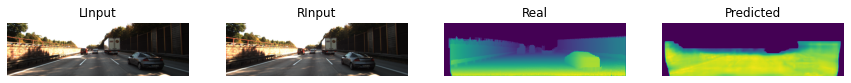

epoch: 63   loss: 10.42021656036377
-------- psnr:  21.915577    ----- epoch:  63   count:  5


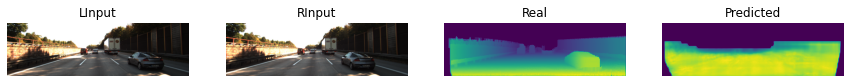

epoch: 64   loss: 10.189085006713867
-------- psnr:  21.92224    ----- epoch:  64   count:  5


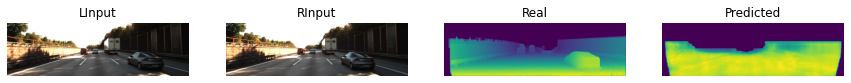

epoch: 65   loss: 9.974692344665527
-------- psnr:  21.810421    ----- epoch:  65   count:  5


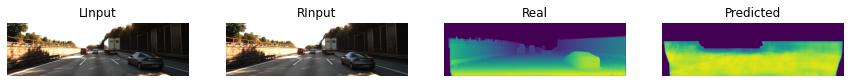

epoch: 66   loss: 9.757871627807617
-------- psnr:  21.723541    ----- epoch:  66   count:  5


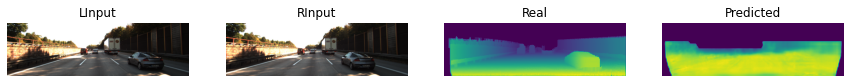

epoch: 67   loss: 9.565711975097656
-------- psnr:  22.198647    ----- epoch:  67   count:  5


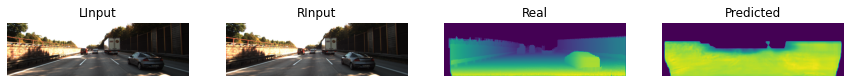

epoch: 68   loss: 9.368480682373047
-------- psnr:  21.733608    ----- epoch:  68   count:  5


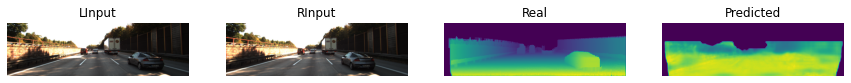

epoch: 69   loss: 9.177257537841797
-------- psnr:  22.241207    ----- epoch:  69   count:  5


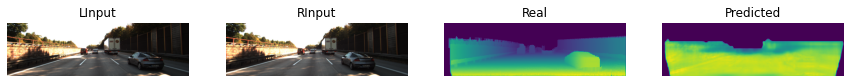

epoch: 70   loss: 8.986052513122559
-------- psnr:  22.103544    ----- epoch:  70   count:  5


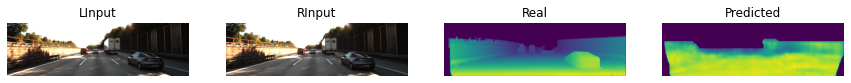

epoch: 71   loss: 8.805596351623535
-------- psnr:  21.984257    ----- epoch:  71   count:  5


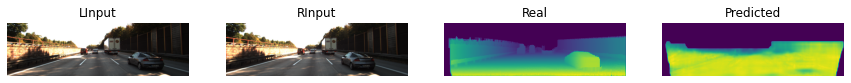

epoch: 72   loss: 8.63093376159668
-------- psnr:  22.15451    ----- epoch:  72   count:  5


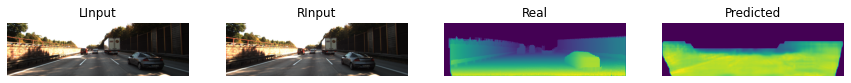

epoch: 73   loss: 8.453207015991211
-------- psnr:  22.168512    ----- epoch:  73   count:  5


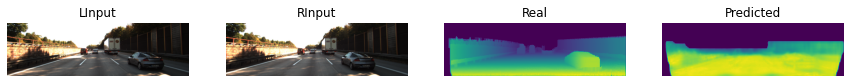

epoch: 74   loss: 8.290793418884277
-------- psnr:  22.294802    ----- epoch:  74   count:  5


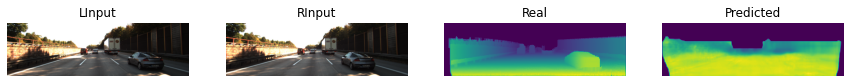

epoch: 75   loss: 8.128966331481934
-------- psnr:  22.288286    ----- epoch:  75   count:  5


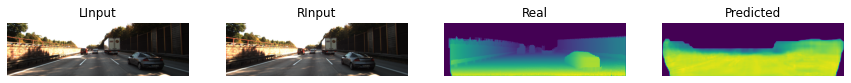

epoch: 76   loss: 7.973176956176758
-------- psnr:  22.722548    ----- epoch:  76   count:  5


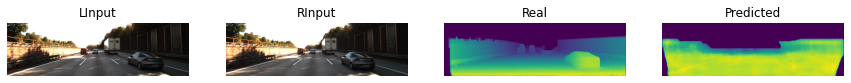

epoch: 77   loss: 7.81154203414917
-------- psnr:  22.65834    ----- epoch:  77   count:  5


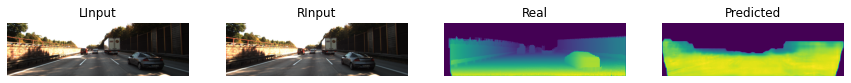

epoch: 78   loss: 7.687370777130127
-------- psnr:  21.405704    ----- epoch:  78   count:  5


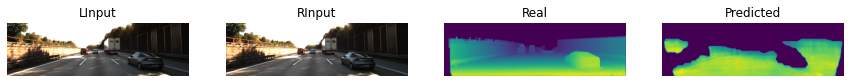

epoch: 79   loss: 7.5425896644592285
-------- psnr:  22.589228    ----- epoch:  79   count:  5


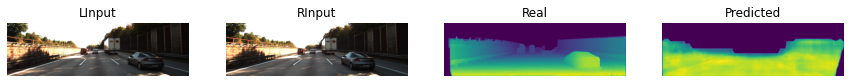

epoch: 80   loss: 7.387414932250977
-------- psnr:  23.207335    ----- epoch:  80   count:  5


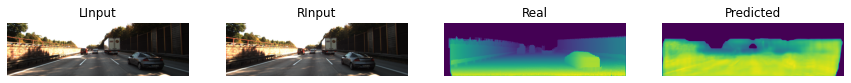

epoch: 81   loss: 7.269263744354248
-------- psnr:  22.85641    ----- epoch:  81   count:  5


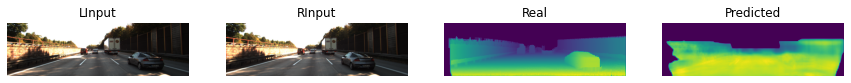

epoch: 82   loss: 7.10683536529541
-------- psnr:  23.011444    ----- epoch:  82   count:  5


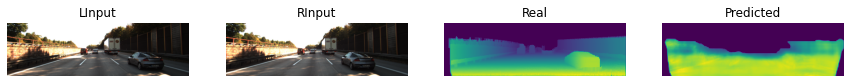

epoch: 83   loss: 6.96513557434082
-------- psnr:  22.703918    ----- epoch:  83   count:  5


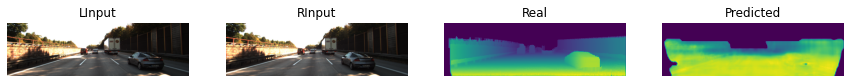

epoch: 84   loss: 6.831217288970947
-------- psnr:  22.747824    ----- epoch:  84   count:  5


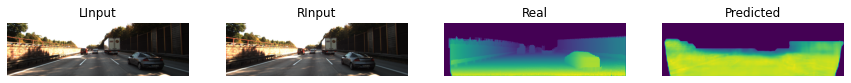

epoch: 85   loss: 6.694541931152344
-------- psnr:  22.953598    ----- epoch:  85   count:  5


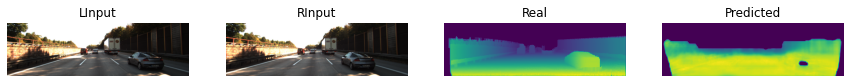

epoch: 86   loss: 6.568454742431641
-------- psnr:  23.087687    ----- epoch:  86   count:  5


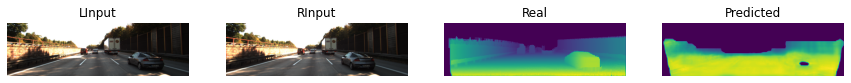

epoch: 87   loss: 6.441883087158203
-------- psnr:  23.096264    ----- epoch:  87   count:  5


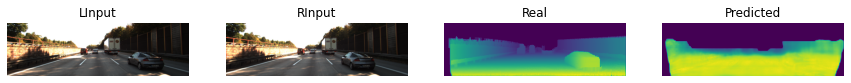

epoch: 88   loss: 6.32819938659668
-------- psnr:  23.310942    ----- epoch:  88   count:  5


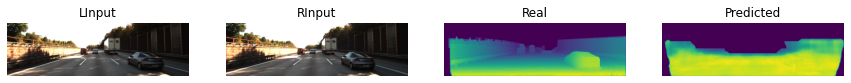

epoch: 89   loss: 6.201628684997559
-------- psnr:  23.138426    ----- epoch:  89   count:  5


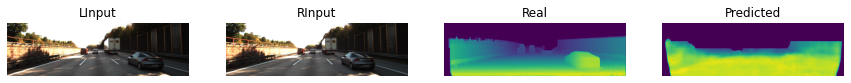

epoch: 90   loss: 6.085292339324951
-------- psnr:  23.422823    ----- epoch:  90   count:  5


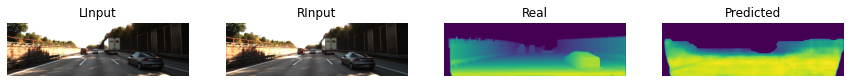

epoch: 91   loss: 5.968801021575928
-------- psnr:  23.522228    ----- epoch:  91   count:  5


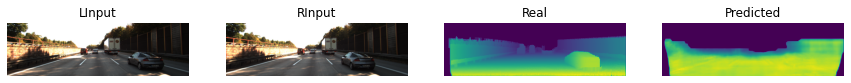

epoch: 92   loss: 5.865900993347168
-------- psnr:  23.308777    ----- epoch:  92   count:  5


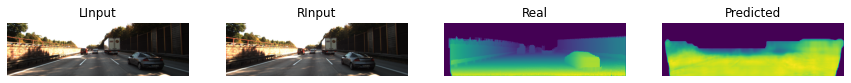

epoch: 93   loss: 5.750965118408203
-------- psnr:  23.278286    ----- epoch:  93   count:  5


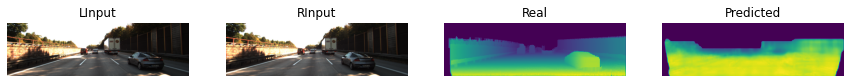

epoch: 94   loss: 5.63605260848999
-------- psnr:  23.420633    ----- epoch:  94   count:  5


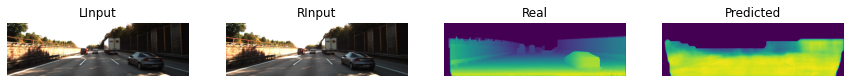

epoch: 95   loss: 5.533169746398926
-------- psnr:  23.556883    ----- epoch:  95   count:  5


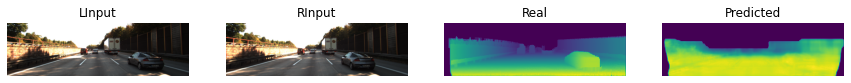

epoch: 96   loss: 5.426999568939209
-------- psnr:  23.446985    ----- epoch:  96   count:  5


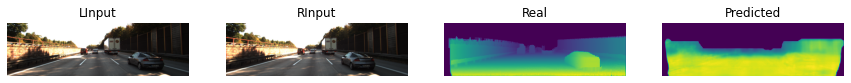

epoch: 97   loss: 5.335810661315918
-------- psnr:  23.90061    ----- epoch:  97   count:  5


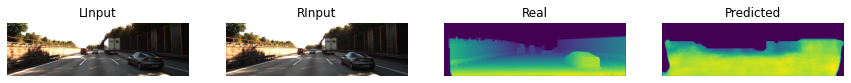

epoch: 98   loss: 5.239138603210449
-------- psnr:  24.04743    ----- epoch:  98   count:  5


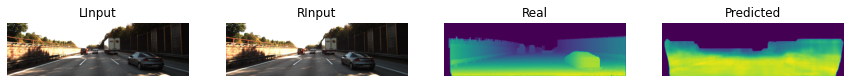

epoch: 99   loss: 5.133386611938477
-------- psnr:  24.585043    ----- epoch:  99   count:  5


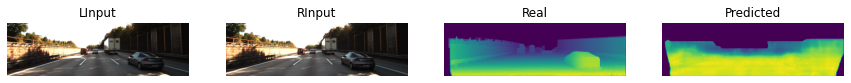

epoch: 100   loss: 5.033117294311523
-------- psnr:  24.06006    ----- epoch:  100   count:  5


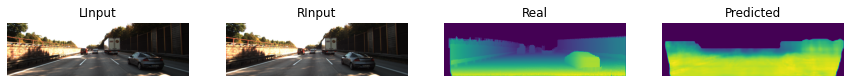

epoch: 101   loss: 4.9391279220581055
-------- psnr:  23.855923    ----- epoch:  101   count:  5


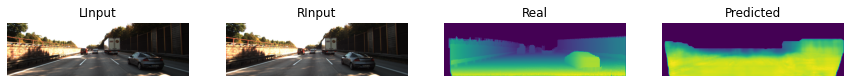

epoch: 102   loss: 4.848206996917725
-------- psnr:  24.022743    ----- epoch:  102   count:  5


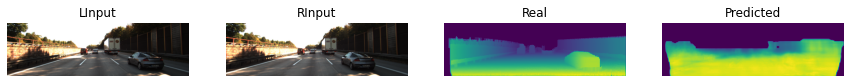

epoch: 103   loss: 4.7565765380859375
-------- psnr:  24.55135    ----- epoch:  103   count:  5


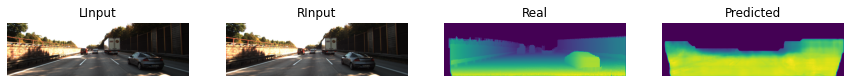

epoch: 104   loss: 4.667702674865723
-------- psnr:  23.93019    ----- epoch:  104   count:  5


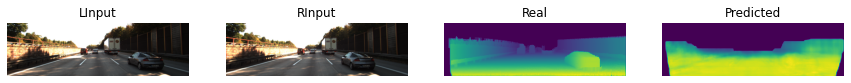

epoch: 105   loss: 4.596534252166748
-------- psnr:  24.727674    ----- epoch:  105   count:  5


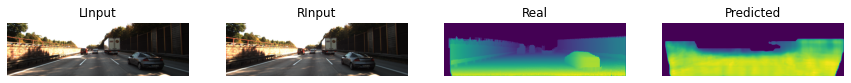

epoch: 106   loss: 4.493836402893066
-------- psnr:  24.371786    ----- epoch:  106   count:  5


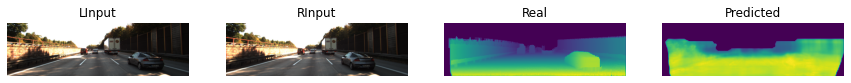

epoch: 107   loss: 4.413819789886475
-------- psnr:  24.893953    ----- epoch:  107   count:  5


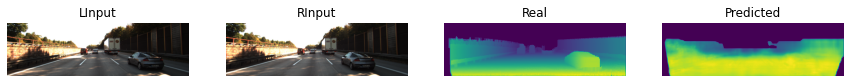

epoch: 108   loss: 4.325006484985352
-------- psnr:  24.372784    ----- epoch:  108   count:  5


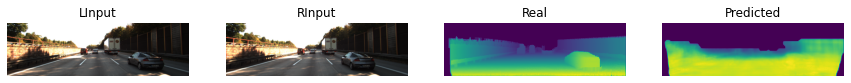

epoch: 109   loss: 4.247649192810059
-------- psnr:  25.105854    ----- epoch:  109   count:  5


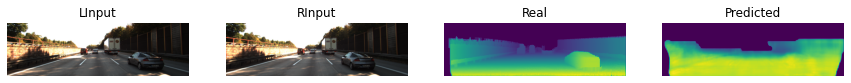

epoch: 110   loss: 4.165595054626465
-------- psnr:  25.044748    ----- epoch:  110   count:  5


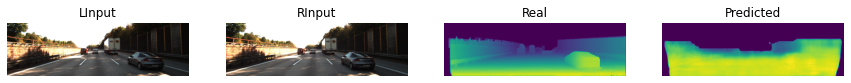

epoch: 111   loss: 4.082569122314453
-------- psnr:  25.272263    ----- epoch:  111   count:  5


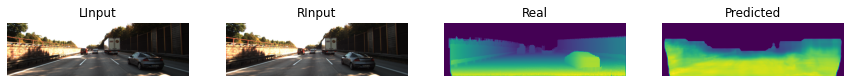

epoch: 112   loss: 4.010062217712402
-------- psnr:  25.46314    ----- epoch:  112   count:  5


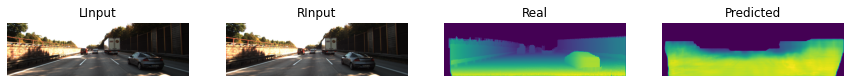

epoch: 113   loss: 3.9474377632141113
-------- psnr:  25.526348    ----- epoch:  113   count:  5


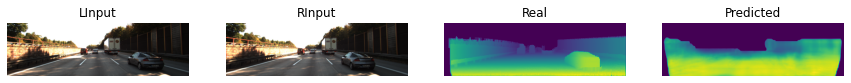

epoch: 114   loss: 3.8621158599853516
-------- psnr:  25.726679    ----- epoch:  114   count:  5


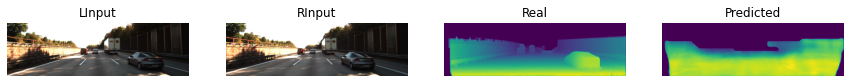

epoch: 115   loss: 3.793557643890381
-------- psnr:  25.30961    ----- epoch:  115   count:  5


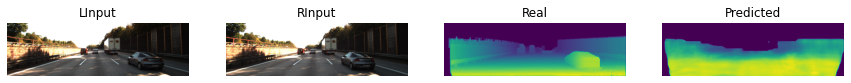

epoch: 116   loss: 3.7214488983154297
-------- psnr:  25.717571    ----- epoch:  116   count:  5


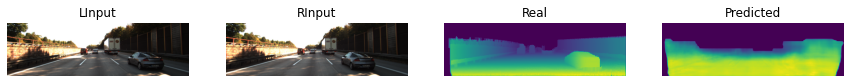

epoch: 117   loss: 3.647576332092285
-------- psnr:  24.453964    ----- epoch:  117   count:  5


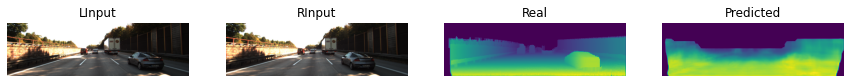

epoch: 118   loss: 3.575129985809326
-------- psnr:  25.504122    ----- epoch:  118   count:  5


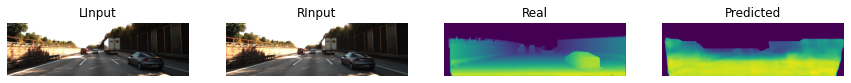

epoch: 119   loss: 3.506049394607544
-------- psnr:  25.730286    ----- epoch:  119   count:  5


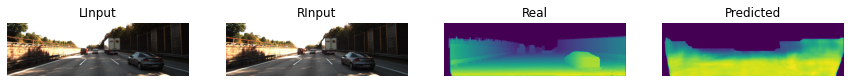

epoch: 120   loss: 3.4385814666748047
-------- psnr:  25.145039    ----- epoch:  120   count:  5


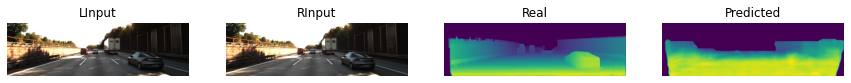

epoch: 121   loss: 3.363178014755249
-------- psnr:  25.552643    ----- epoch:  121   count:  5


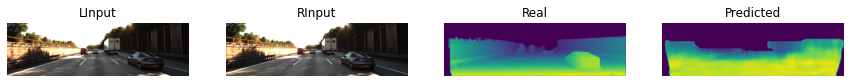

epoch: 122   loss: 3.300563097000122
-------- psnr:  26.311611    ----- epoch:  122   count:  5


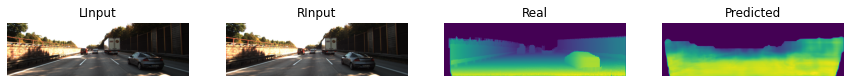

epoch: 123   loss: 3.246018648147583
-------- psnr:  26.16164    ----- epoch:  123   count:  5


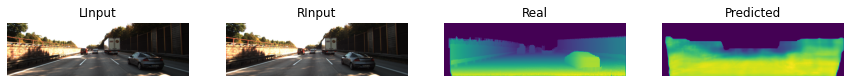

epoch: 124   loss: 3.1799392700195312
-------- psnr:  26.579136    ----- epoch:  124   count:  5


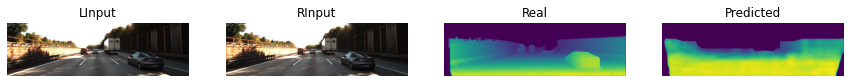

epoch: 125   loss: 3.1102397441864014
-------- psnr:  26.245983    ----- epoch:  125   count:  5


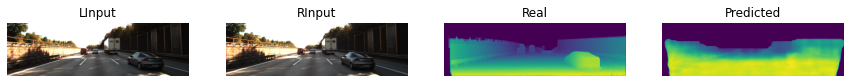

epoch: 126   loss: 3.0426506996154785
-------- psnr:  26.093582    ----- epoch:  126   count:  5


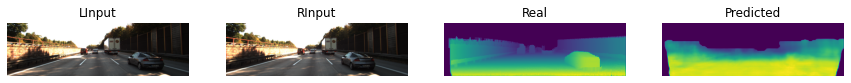

epoch: 127   loss: 2.9821383953094482
-------- psnr:  26.280918    ----- epoch:  127   count:  5


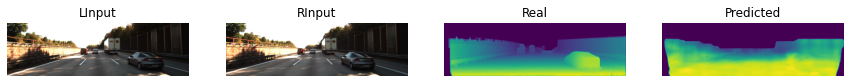

epoch: 128   loss: 2.925962209701538
-------- psnr:  26.829062    ----- epoch:  128   count:  5


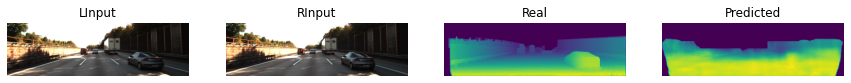

epoch: 129   loss: 2.868335247039795
-------- psnr:  26.293194    ----- epoch:  129   count:  5


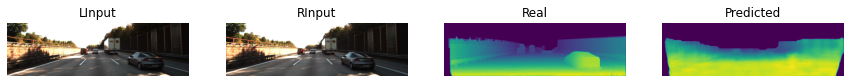

epoch: 130   loss: 2.805795192718506
-------- psnr:  26.150417    ----- epoch:  130   count:  5


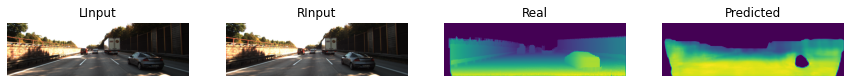

epoch: 131   loss: 2.744872570037842
-------- psnr:  26.768208    ----- epoch:  131   count:  5


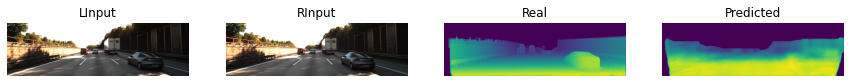

epoch: 132   loss: 2.69759464263916
-------- psnr:  26.892767    ----- epoch:  132   count:  5


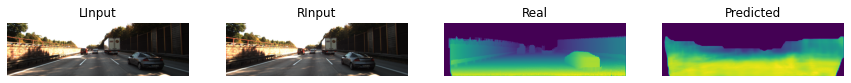

epoch: 133   loss: 2.6331489086151123
-------- psnr:  27.085962    ----- epoch:  133   count:  5


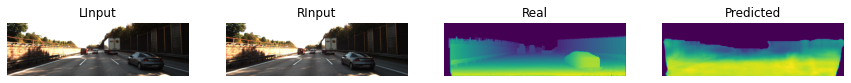

epoch: 134   loss: 2.6003434658050537
-------- psnr:  27.572601    ----- epoch:  134   count:  5


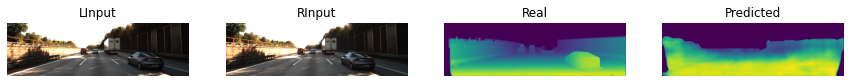

epoch: 135   loss: 2.531045913696289
-------- psnr:  26.799389    ----- epoch:  135   count:  5


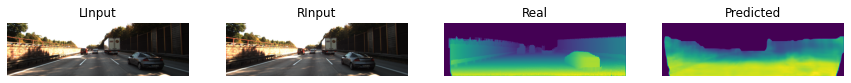

epoch: 136   loss: 2.4689645767211914
-------- psnr:  27.188934    ----- epoch:  136   count:  5


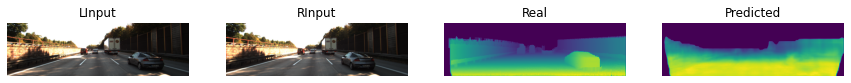

epoch: 137   loss: 2.42231822013855
-------- psnr:  27.290054    ----- epoch:  137   count:  5


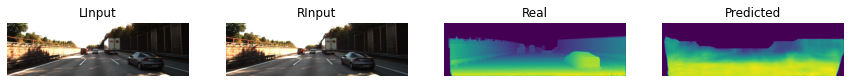

epoch: 138   loss: 2.3709523677825928
-------- psnr:  28.323542    ----- epoch:  138   count:  5


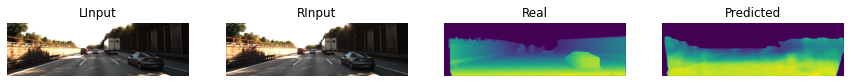

epoch: 139   loss: 2.3344075679779053
-------- psnr:  28.017426    ----- epoch:  139   count:  5


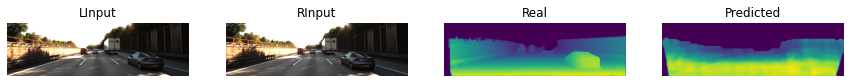

epoch: 140   loss: 2.2753686904907227
-------- psnr:  27.88953    ----- epoch:  140   count:  5


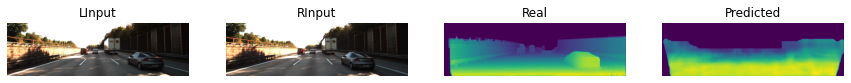

epoch: 141   loss: 2.2160613536834717
-------- psnr:  27.508282    ----- epoch:  141   count:  5


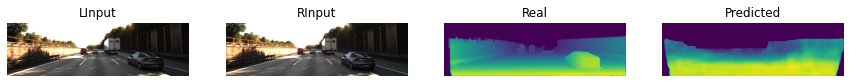

epoch: 142   loss: 2.1729719638824463
-------- psnr:  27.820232    ----- epoch:  142   count:  5


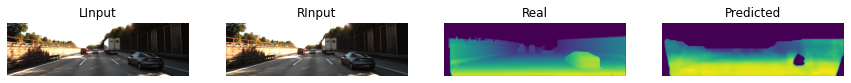

epoch: 143   loss: 2.1159658432006836
-------- psnr:  27.702948    ----- epoch:  143   count:  5


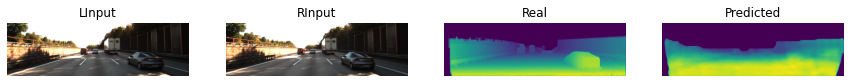

epoch: 144   loss: 2.0708727836608887
-------- psnr:  28.163883    ----- epoch:  144   count:  5


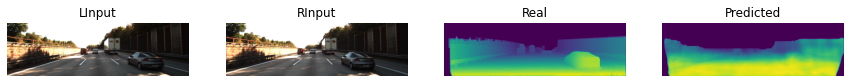

epoch: 145   loss: 2.021233320236206
-------- psnr:  28.431091    ----- epoch:  145   count:  5


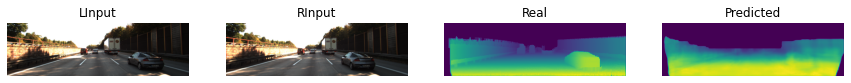

epoch: 146   loss: 1.9796574115753174
-------- psnr:  29.016094    ----- epoch:  146   count:  5


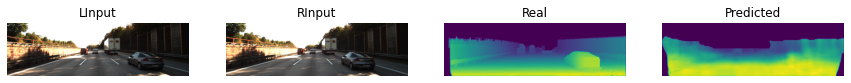

epoch: 147   loss: 1.9362475872039795
-------- psnr:  29.021353    ----- epoch:  147   count:  5


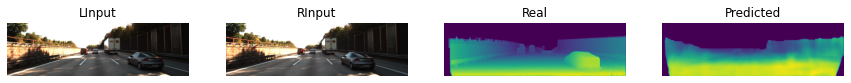

epoch: 148   loss: 1.8905774354934692
-------- psnr:  28.755787    ----- epoch:  148   count:  5


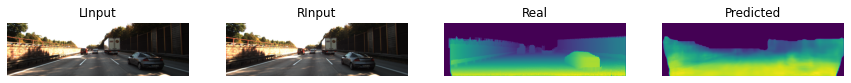

epoch: 149   loss: 1.8479961156845093
-------- psnr:  28.444452    ----- epoch:  149   count:  5


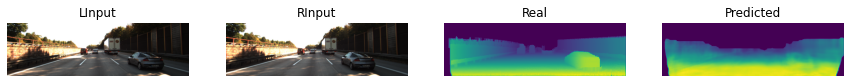

epoch: 150   loss: 1.8037660121917725
-------- psnr:  29.264206    ----- epoch:  150   count:  5


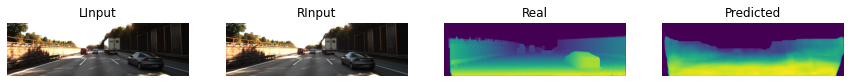

epoch: 151   loss: 1.7573668956756592
-------- psnr:  29.624989    ----- epoch:  151   count:  5


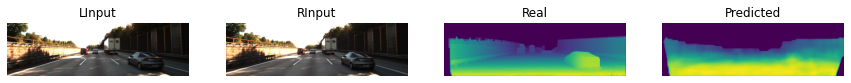

epoch: 152   loss: 1.721964716911316
-------- psnr:  29.863354    ----- epoch:  152   count:  5


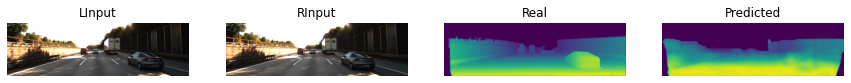

epoch: 153   loss: 1.6765474081039429
-------- psnr:  28.845184    ----- epoch:  153   count:  5


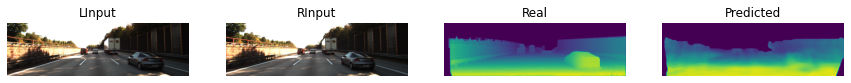

epoch: 154   loss: 1.6507010459899902
-------- psnr:  29.426306    ----- epoch:  154   count:  5


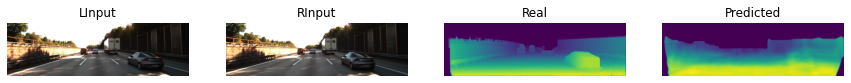

epoch: 155   loss: 1.5985345840454102
-------- psnr:  29.121893    ----- epoch:  155   count:  5


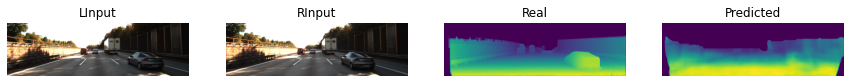

epoch: 156   loss: 1.5466725826263428
-------- psnr:  29.799963    ----- epoch:  156   count:  5


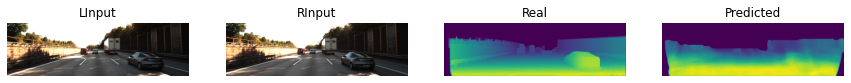

epoch: 157   loss: 1.5122019052505493
-------- psnr:  29.994379    ----- epoch:  157   count:  5


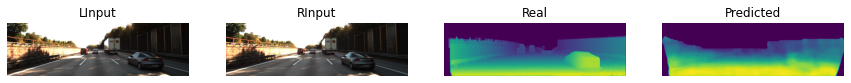

epoch: 158   loss: 1.4906412363052368
-------- psnr:  30.434713    ----- epoch:  158   count:  5


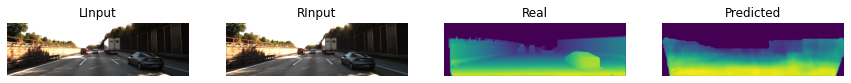

epoch: 159   loss: 1.4301466941833496
-------- psnr:  30.119894    ----- epoch:  159   count:  5


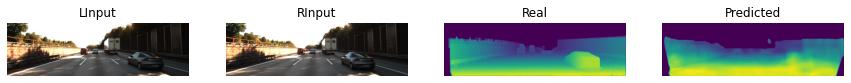

epoch: 160   loss: 1.4011056423187256
-------- psnr:  30.120075    ----- epoch:  160   count:  5


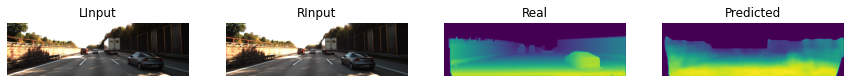

epoch: 161   loss: 1.353144645690918
-------- psnr:  30.103449    ----- epoch:  161   count:  5


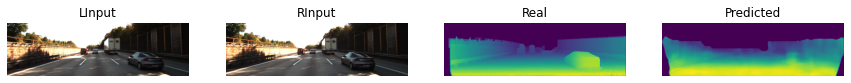

epoch: 162   loss: 1.333153247833252
-------- psnr:  30.285587    ----- epoch:  162   count:  5


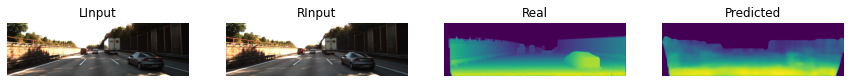

epoch: 163   loss: 1.291770577430725
-------- psnr:  30.38338    ----- epoch:  163   count:  5


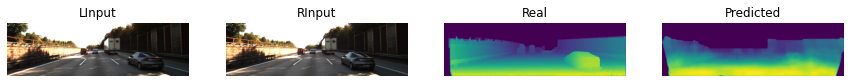

epoch: 164   loss: 1.2496343851089478
-------- psnr:  30.659054    ----- epoch:  164   count:  5


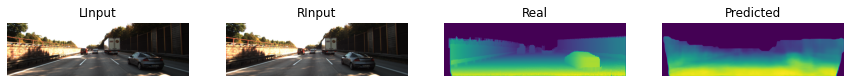

epoch: 165   loss: 1.2352590560913086
-------- psnr:  29.972122    ----- epoch:  165   count:  5


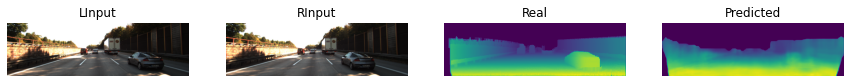

epoch: 166   loss: 1.1802868843078613
-------- psnr:  31.246546    ----- epoch:  166   count:  5


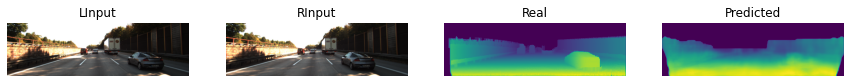

epoch: 167   loss: 1.1557663679122925
-------- psnr:  30.98063    ----- epoch:  167   count:  5


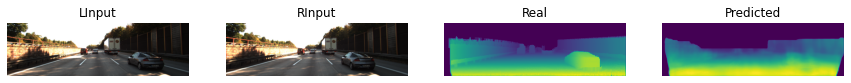

epoch: 168   loss: 1.1024467945098877
-------- psnr:  31.57996    ----- epoch:  168   count:  5


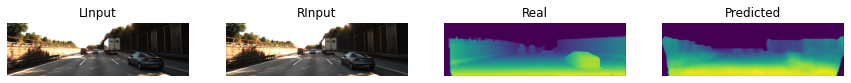

epoch: 169   loss: 1.107838749885559
-------- psnr:  30.545834    ----- epoch:  169   count:  5


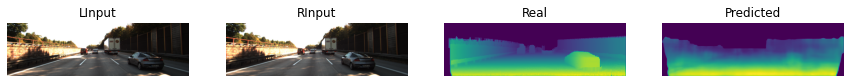

epoch: 170   loss: 1.0585191249847412
-------- psnr:  31.228888    ----- epoch:  170   count:  5


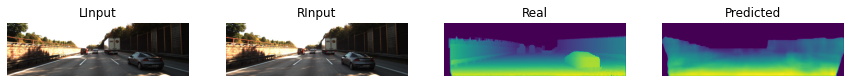

epoch: 171   loss: 1.0240883827209473
-------- psnr:  31.05511    ----- epoch:  171   count:  5


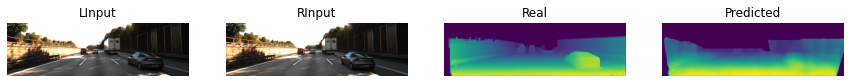

epoch: 172   loss: 1.0030204057693481
-------- psnr:  30.889896    ----- epoch:  172   count:  5


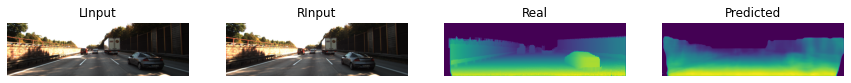

epoch: 173   loss: 0.983337938785553
-------- psnr:  31.233814    ----- epoch:  173   count:  5


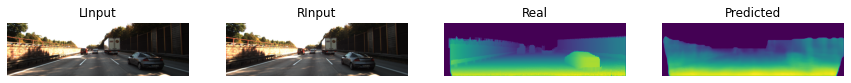

epoch: 174   loss: 0.9368430972099304
-------- psnr:  31.302801    ----- epoch:  174   count:  5


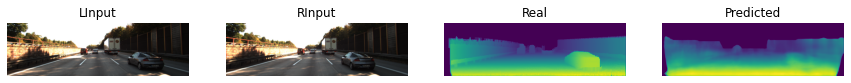

epoch: 175   loss: 0.9145377278327942
-------- psnr:  31.16785    ----- epoch:  175   count:  5


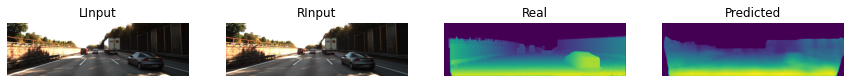

epoch: 176   loss: 0.9091593623161316
-------- psnr:  28.914194    ----- epoch:  176   count:  5


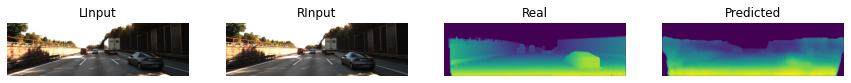

epoch: 177   loss: 0.8628734946250916
-------- psnr:  31.37589    ----- epoch:  177   count:  5


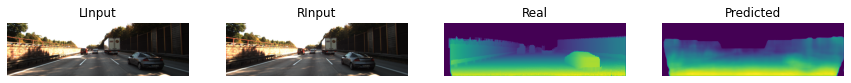

epoch: 178   loss: 0.8490909337997437
-------- psnr:  31.496944    ----- epoch:  178   count:  5


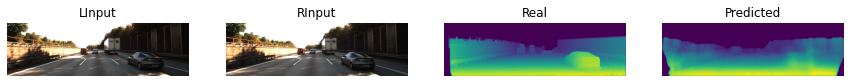

epoch: 179   loss: 0.8226341605186462
-------- psnr:  30.985886    ----- epoch:  179   count:  5


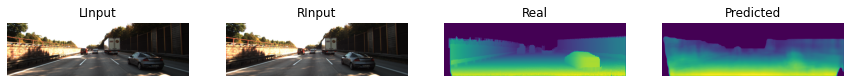

epoch: 180   loss: 0.8244826793670654
-------- psnr:  30.096542    ----- epoch:  180   count:  5


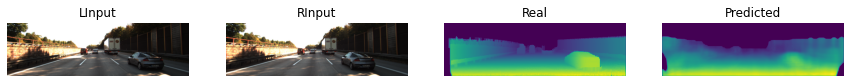

epoch: 181   loss: 0.7932652831077576
-------- psnr:  32.140568    ----- epoch:  181   count:  5


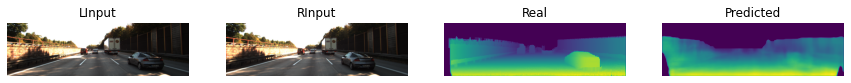

epoch: 182   loss: 0.7517251968383789
-------- psnr:  31.995678    ----- epoch:  182   count:  5


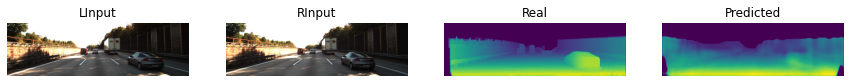

epoch: 183   loss: 0.7137450575828552
-------- psnr:  31.756485    ----- epoch:  183   count:  5


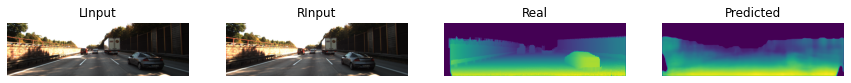

epoch: 184   loss: 0.7006996273994446
-------- psnr:  31.990185    ----- epoch:  184   count:  5


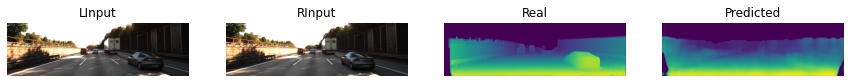

epoch: 185   loss: 0.694199800491333
-------- psnr:  31.827902    ----- epoch:  185   count:  5


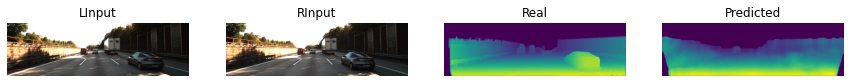

epoch: 186   loss: 0.6764179468154907
-------- psnr:  30.022457    ----- epoch:  186   count:  5


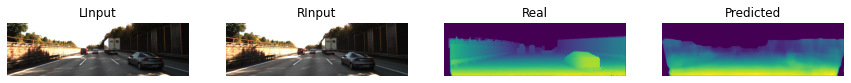

epoch: 187   loss: 0.6464255452156067
-------- psnr:  30.716496    ----- epoch:  187   count:  5


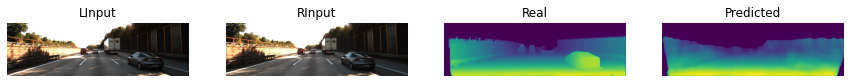

epoch: 188   loss: 0.6377244591712952
-------- psnr:  32.438976    ----- epoch:  188   count:  5


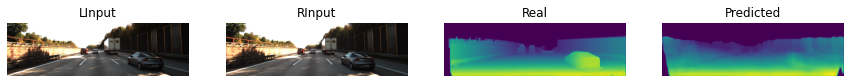

epoch: 189   loss: 0.6242604851722717
-------- psnr:  32.84338    ----- epoch:  189   count:  5


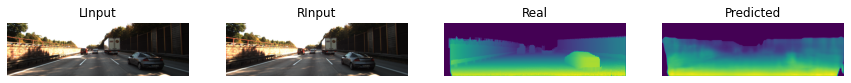

epoch: 190   loss: 0.5961170792579651
-------- psnr:  32.892876    ----- epoch:  190   count:  5


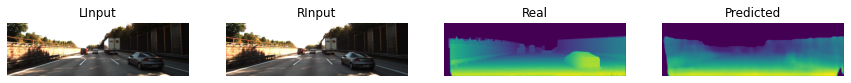

epoch: 191   loss: 0.5786494016647339
-------- psnr:  32.369892    ----- epoch:  191   count:  5


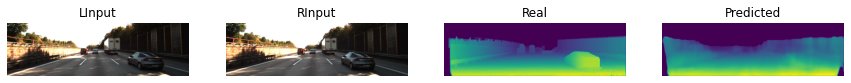

epoch: 192   loss: 0.5797253847122192
-------- psnr:  32.832542    ----- epoch:  192   count:  5


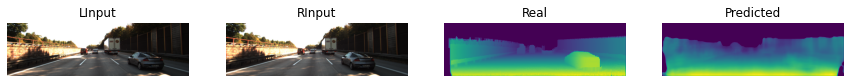

epoch: 193   loss: 0.5576404333114624
-------- psnr:  31.635061    ----- epoch:  193   count:  5


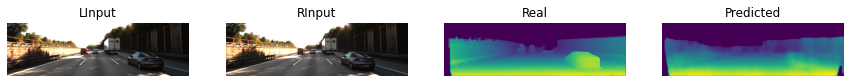

epoch: 194   loss: 0.5549039840698242
-------- psnr:  31.783825    ----- epoch:  194   count:  5


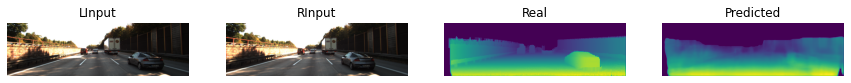

epoch: 195   loss: 0.5322800278663635
-------- psnr:  32.887512    ----- epoch:  195   count:  5


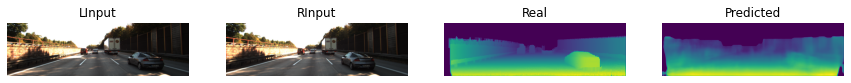

epoch: 196   loss: 0.5276286005973816
-------- psnr:  31.84614    ----- epoch:  196   count:  5


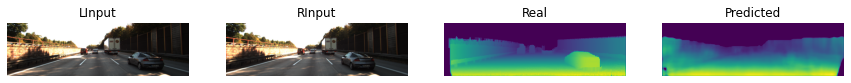

epoch: 197   loss: 0.5154446363449097
-------- psnr:  33.24242    ----- epoch:  197   count:  5


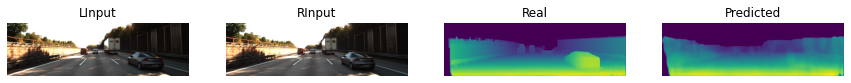

epoch: 198   loss: 0.5074355602264404
-------- psnr:  33.08213    ----- epoch:  198   count:  5


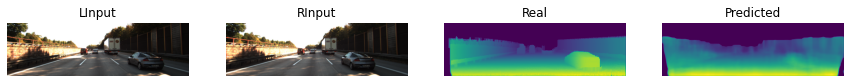

epoch: 199   loss: 0.4665294587612152
-------- psnr:  32.142258    ----- epoch:  199   count:  5


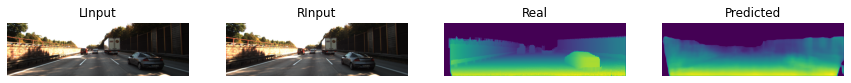

epoch: 200   loss: 0.476863831281662
-------- psnr:  32.89993    ----- epoch:  200   count:  5


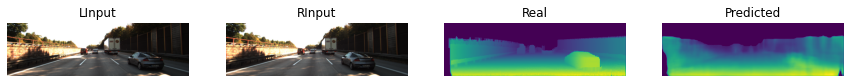

epoch: 201   loss: 0.48692741990089417
-------- psnr:  32.650036    ----- epoch:  201   count:  5


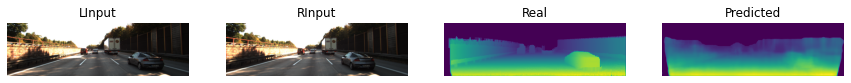

epoch: 202   loss: 0.47542068362236023
-------- psnr:  31.598934    ----- epoch:  202   count:  5


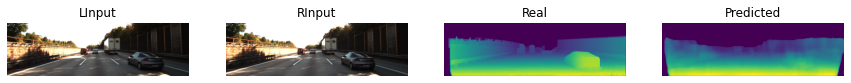

epoch: 203   loss: 0.44291219115257263
-------- psnr:  32.659595    ----- epoch:  203   count:  5


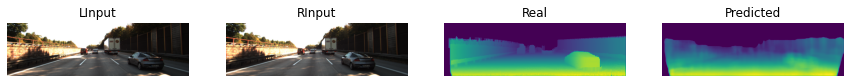

epoch: 204   loss: 0.4513421356678009
-------- psnr:  32.53332    ----- epoch:  204   count:  5


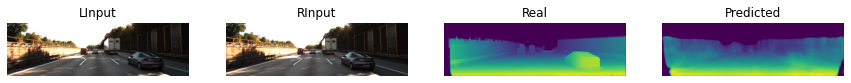

epoch: 205   loss: 0.4356789290904999
-------- psnr:  32.243423    ----- epoch:  205   count:  5


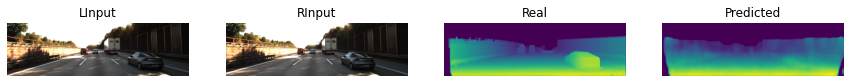

epoch: 206   loss: 0.4164241850376129
-------- psnr:  32.796803    ----- epoch:  206   count:  5


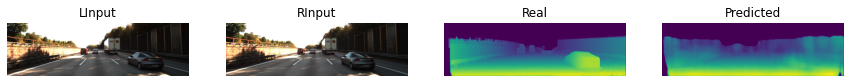

epoch: 207   loss: 0.43081918358802795
-------- psnr:  33.157715    ----- epoch:  207   count:  5


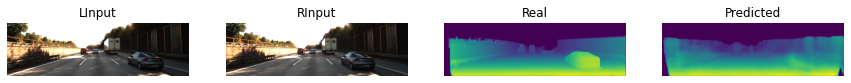

epoch: 208   loss: 0.43176034092903137
-------- psnr:  33.11757    ----- epoch:  208   count:  5


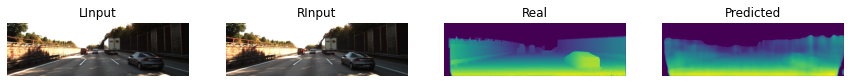

epoch: 209   loss: 0.4041675329208374
-------- psnr:  32.396168    ----- epoch:  209   count:  5


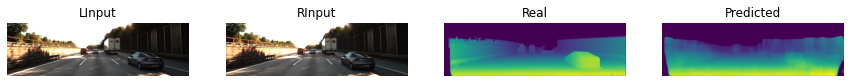

epoch: 210   loss: 0.40008020401000977
-------- psnr:  33.19551    ----- epoch:  210   count:  5


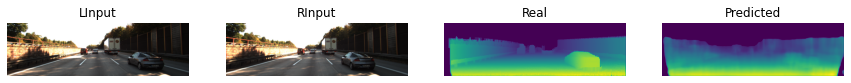

epoch: 211   loss: 0.3798130452632904
-------- psnr:  32.396435    ----- epoch:  211   count:  5


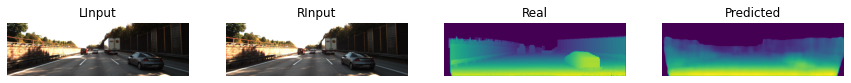

epoch: 212   loss: 0.4085036516189575
-------- psnr:  33.31408    ----- epoch:  212   count:  5


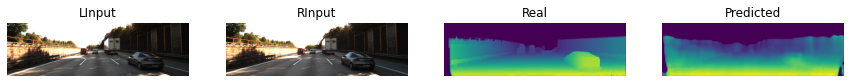

epoch: 213   loss: 0.39337965846061707
-------- psnr:  32.978424    ----- epoch:  213   count:  5


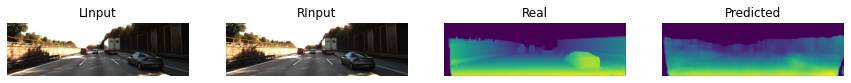

epoch: 214   loss: 0.3791531026363373
-------- psnr:  32.899178    ----- epoch:  214   count:  5


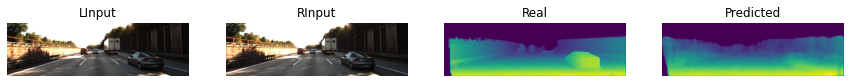

epoch: 215   loss: 0.37696340680122375
-------- psnr:  32.849957    ----- epoch:  215   count:  5


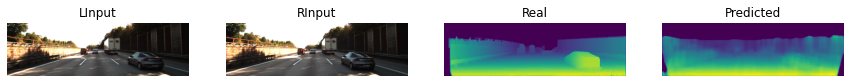

epoch: 216   loss: 0.35543617606163025
-------- psnr:  32.936123    ----- epoch:  216   count:  5


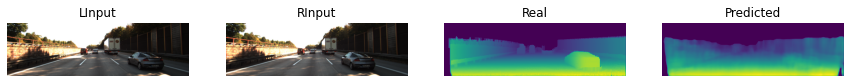

epoch: 217   loss: 0.36141878366470337
-------- psnr:  32.627895    ----- epoch:  217   count:  5


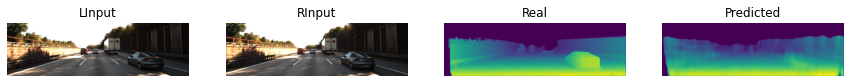

epoch: 218   loss: 0.36726507544517517
-------- psnr:  32.754112    ----- epoch:  218   count:  5


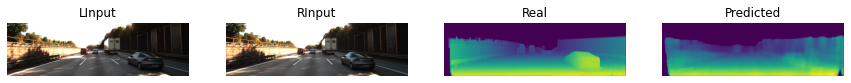

epoch: 219   loss: 0.36449119448661804
-------- psnr:  32.92399    ----- epoch:  219   count:  5


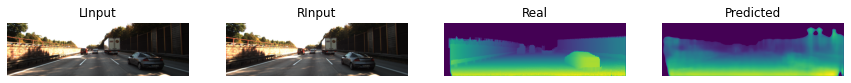

epoch: 220   loss: 0.3707275688648224
-------- psnr:  34.162254    ----- epoch:  220   count:  5


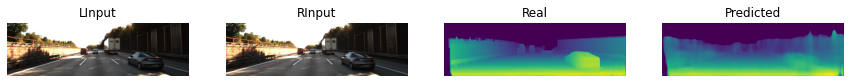

epoch: 221   loss: 0.3404369056224823
-------- psnr:  33.17549    ----- epoch:  221   count:  5


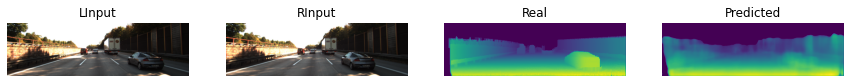

epoch: 222   loss: 0.3462730348110199
-------- psnr:  32.641495    ----- epoch:  222   count:  5


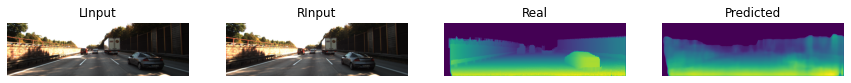

epoch: 223   loss: 0.3287583887577057
-------- psnr:  32.780735    ----- epoch:  223   count:  5


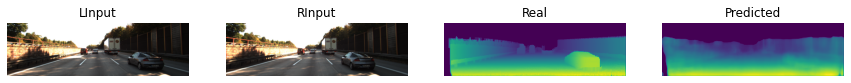

epoch: 224   loss: 0.3536364734172821
-------- psnr:  34.049107    ----- epoch:  224   count:  5


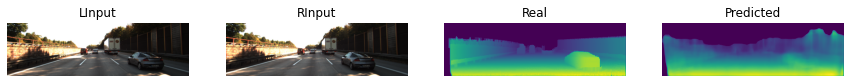

epoch: 225   loss: 0.3219015598297119
-------- psnr:  33.83007    ----- epoch:  225   count:  5


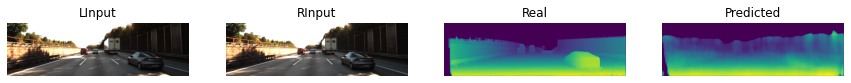

epoch: 226   loss: 0.3272937834262848
-------- psnr:  33.635822    ----- epoch:  226   count:  5


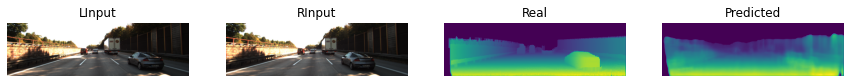

epoch: 227   loss: 0.3273946940898895
-------- psnr:  33.8881    ----- epoch:  227   count:  5


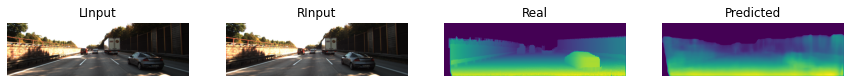

epoch: 228   loss: 0.3140445053577423
-------- psnr:  33.591576    ----- epoch:  228   count:  5


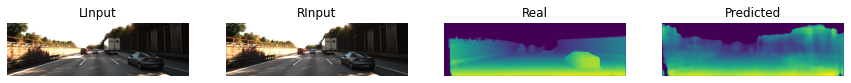

epoch: 229   loss: 0.3145659863948822
-------- psnr:  33.350395    ----- epoch:  229   count:  5


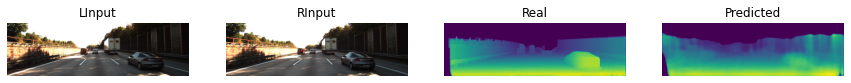

epoch: 230   loss: 0.3117237091064453
-------- psnr:  34.109913    ----- epoch:  230   count:  5


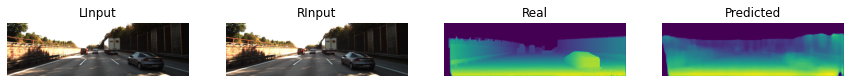

epoch: 231   loss: 0.3369513750076294
-------- psnr:  33.57011    ----- epoch:  231   count:  5


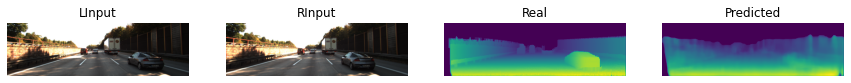

epoch: 232   loss: 0.31267011165618896
-------- psnr:  33.887787    ----- epoch:  232   count:  5


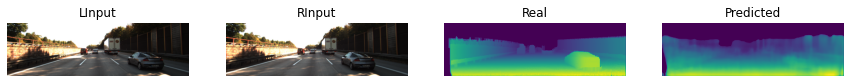

epoch: 233   loss: 0.31040239334106445
-------- psnr:  33.600132    ----- epoch:  233   count:  5


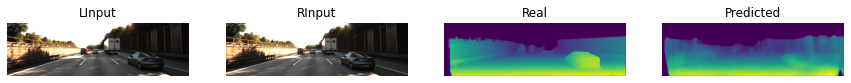

epoch: 234   loss: 0.32313838601112366
-------- psnr:  33.994213    ----- epoch:  234   count:  5


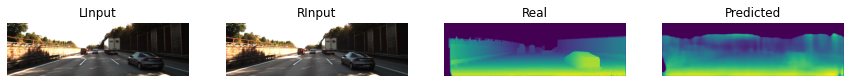

epoch: 235   loss: 0.3017992675304413
-------- psnr:  34.19605    ----- epoch:  235   count:  5


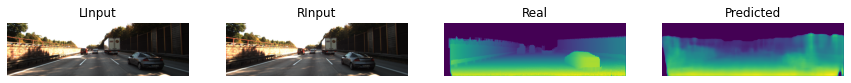

epoch: 236   loss: 0.29052042961120605
-------- psnr:  33.866875    ----- epoch:  236   count:  5


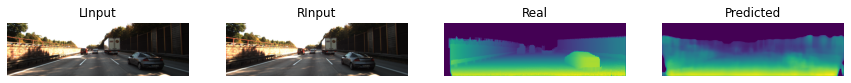

epoch: 237   loss: 0.3065228760242462
-------- psnr:  33.97587    ----- epoch:  237   count:  5


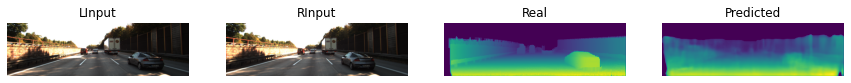

epoch: 238   loss: 0.30866628885269165
-------- psnr:  32.799927    ----- epoch:  238   count:  5


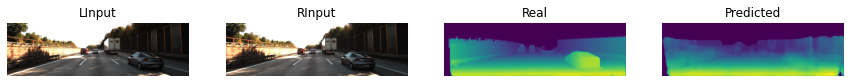

epoch: 239   loss: 0.29546380043029785
-------- psnr:  33.838844    ----- epoch:  239   count:  5


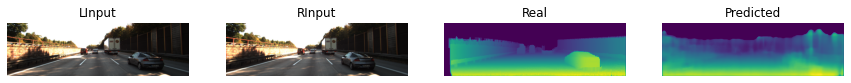

epoch: 240   loss: 0.280870646238327
-------- psnr:  33.578827    ----- epoch:  240   count:  5


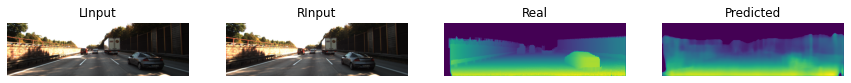

epoch: 241   loss: 0.2700374126434326
-------- psnr:  33.98571    ----- epoch:  241   count:  5


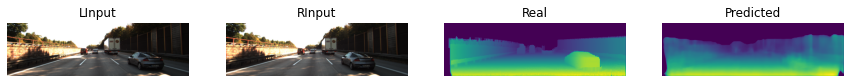

epoch: 242   loss: 0.27734407782554626
-------- psnr:  33.37737    ----- epoch:  242   count:  5


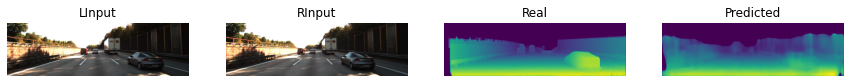

epoch: 243   loss: 0.2740364670753479
-------- psnr:  33.93901    ----- epoch:  243   count:  5


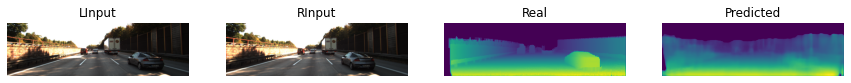

epoch: 244   loss: 0.2704547345638275
-------- psnr:  34.278942    ----- epoch:  244   count:  5


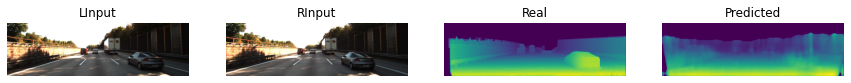

epoch: 245   loss: 0.2658476233482361
-------- psnr:  33.63891    ----- epoch:  245   count:  5


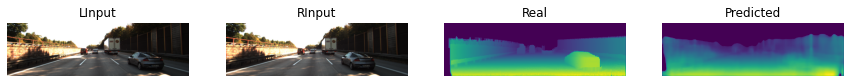

epoch: 246   loss: 0.26146918535232544
-------- psnr:  34.084427    ----- epoch:  246   count:  5


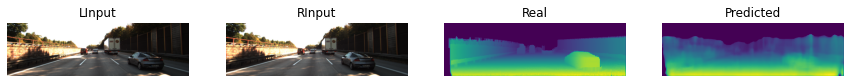

epoch: 247   loss: 0.2838978171348572
-------- psnr:  33.46796    ----- epoch:  247   count:  5


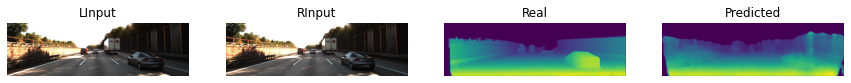

epoch: 248   loss: 0.25619447231292725
-------- psnr:  33.72378    ----- epoch:  248   count:  5


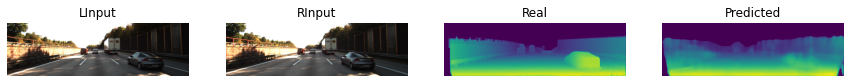

epoch: 249   loss: 0.2532224655151367
-------- psnr:  33.481377    ----- epoch:  249   count:  5


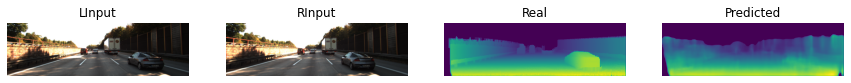

epoch: 250   loss: 0.2478099763393402
-------- psnr:  33.285732    ----- epoch:  250   count:  5


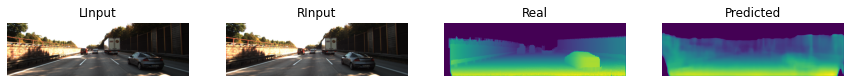

epoch: 251   loss: 0.24897870421409607
-------- psnr:  34.00408    ----- epoch:  251   count:  5


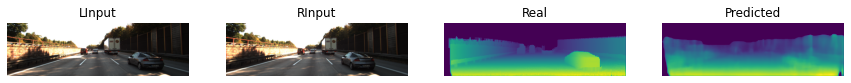

epoch: 252   loss: 0.24800029397010803
-------- psnr:  33.885838    ----- epoch:  252   count:  5


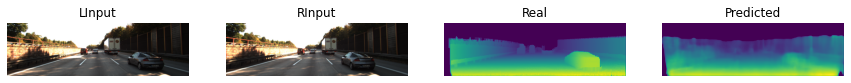

epoch: 253   loss: 0.26183193922042847
-------- psnr:  34.138283    ----- epoch:  253   count:  5


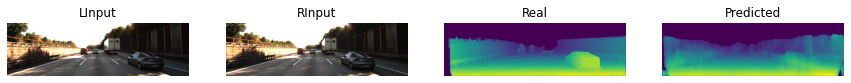

epoch: 254   loss: 0.24913382530212402
-------- psnr:  33.690506    ----- epoch:  254   count:  5


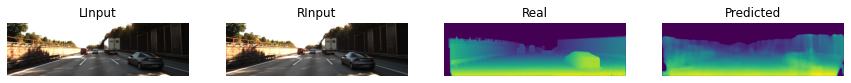

epoch: 255   loss: 0.2579789459705353
-------- psnr:  32.449623    ----- epoch:  255   count:  5


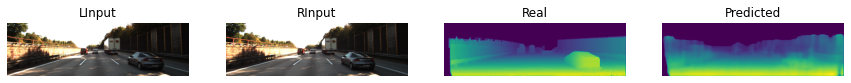

epoch: 256   loss: 0.25024160742759705
-------- psnr:  33.473366    ----- epoch:  256   count:  5


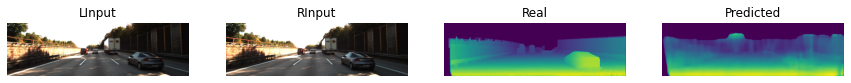

epoch: 257   loss: 0.24586477875709534
-------- psnr:  33.17634    ----- epoch:  257   count:  5


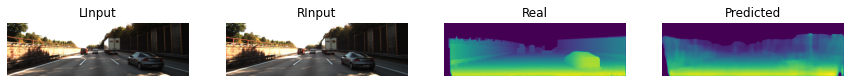

epoch: 258   loss: 0.21975822746753693
-------- psnr:  34.156513    ----- epoch:  258   count:  5


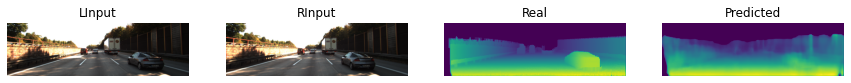

epoch: 259   loss: 0.25214987993240356
-------- psnr:  33.75504    ----- epoch:  259   count:  5


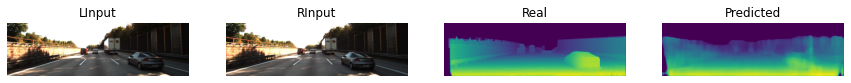

epoch: 260   loss: 0.25293537974357605
-------- psnr:  33.59392    ----- epoch:  260   count:  5


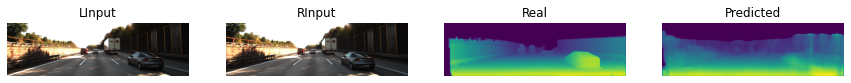

epoch: 261   loss: 0.22859753668308258
-------- psnr:  33.632256    ----- epoch:  261   count:  5


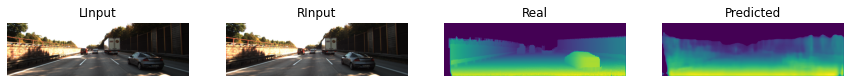

epoch: 262   loss: 0.22901180386543274
-------- psnr:  33.75858    ----- epoch:  262   count:  5


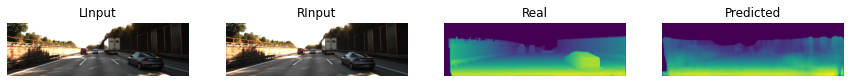

epoch: 263   loss: 0.2218390554189682
-------- psnr:  33.912098    ----- epoch:  263   count:  5


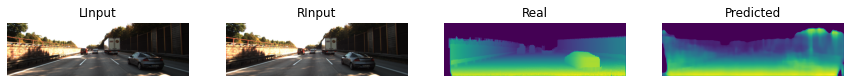

epoch: 264   loss: 0.22806280851364136
-------- psnr:  33.71996    ----- epoch:  264   count:  5


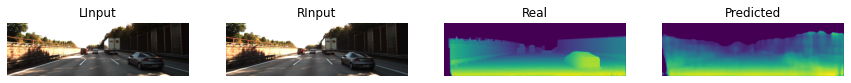

epoch: 265   loss: 0.2288077026605606
-------- psnr:  33.863712    ----- epoch:  265   count:  5


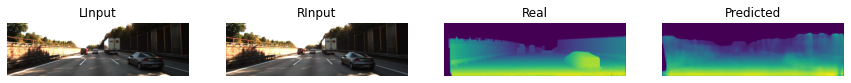

epoch: 266   loss: 0.22848257422447205
-------- psnr:  34.27387    ----- epoch:  266   count:  5


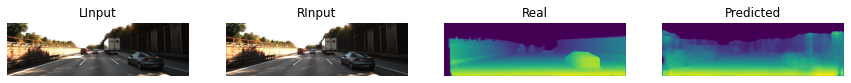

epoch: 267   loss: 0.22147193551063538
-------- psnr:  33.923096    ----- epoch:  267   count:  5


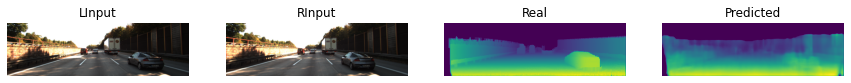

epoch: 268   loss: 0.2081347107887268
-------- psnr:  34.058075    ----- epoch:  268   count:  5


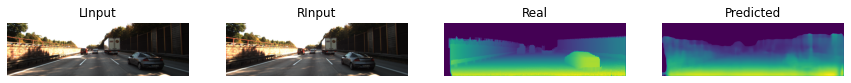

epoch: 269   loss: 0.21344301104545593
-------- psnr:  33.598743    ----- epoch:  269   count:  5


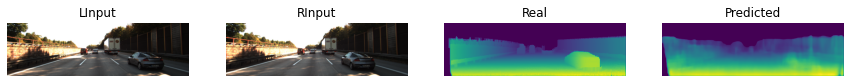

epoch: 270   loss: 0.23486542701721191
-------- psnr:  33.714607    ----- epoch:  270   count:  5


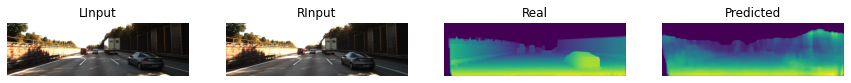

epoch: 271   loss: 0.20694072544574738
-------- psnr:  33.63204    ----- epoch:  271   count:  5


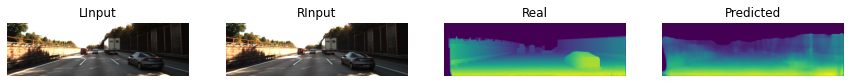

epoch: 272   loss: 0.21095703542232513
-------- psnr:  33.93528    ----- epoch:  272   count:  5


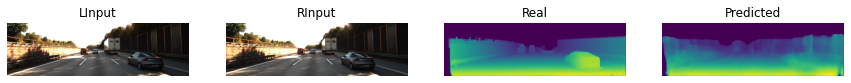

epoch: 273   loss: 0.21729281544685364
-------- psnr:  34.21957    ----- epoch:  273   count:  5


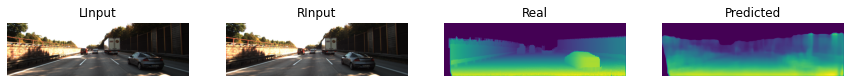

epoch: 274   loss: 0.20478735864162445
-------- psnr:  34.391785    ----- epoch:  274   count:  5


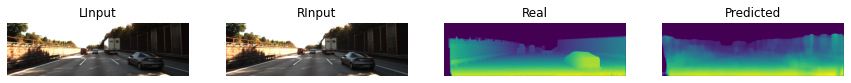

epoch: 275   loss: 0.2108415961265564
-------- psnr:  34.34427    ----- epoch:  275   count:  5


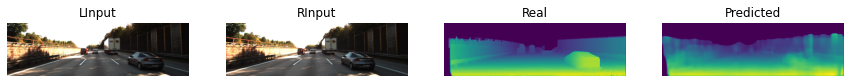

epoch: 276   loss: 0.20135852694511414
-------- psnr:  34.51999    ----- epoch:  276   count:  5


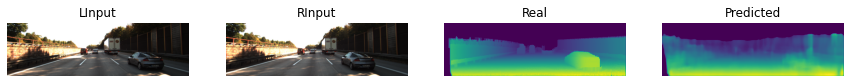

epoch: 277   loss: 0.20343829691410065
-------- psnr:  34.15017    ----- epoch:  277   count:  5


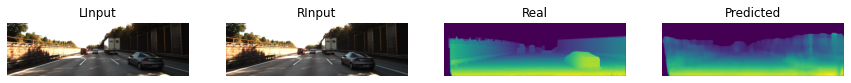

epoch: 278   loss: 0.19646744430065155
-------- psnr:  33.92881    ----- epoch:  278   count:  5


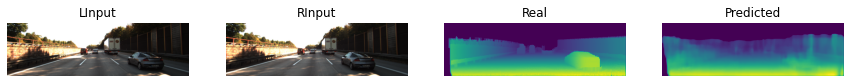

epoch: 279   loss: 0.20034942030906677
-------- psnr:  33.77248    ----- epoch:  279   count:  5


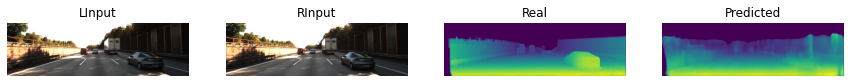

epoch: 280   loss: 0.21158964931964874
-------- psnr:  34.27905    ----- epoch:  280   count:  5


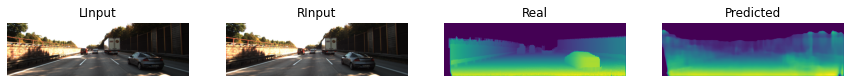

epoch: 281   loss: 0.19004806876182556
-------- psnr:  33.89837    ----- epoch:  281   count:  5


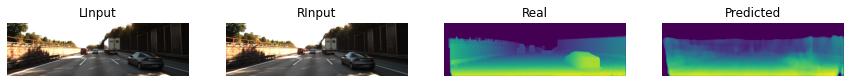

epoch: 282   loss: 0.20471517741680145
-------- psnr:  33.06316    ----- epoch:  282   count:  5


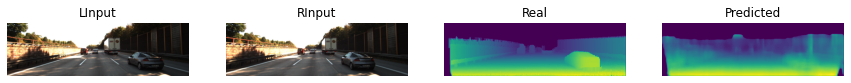

epoch: 283   loss: 0.19847816228866577
-------- psnr:  34.401783    ----- epoch:  283   count:  5


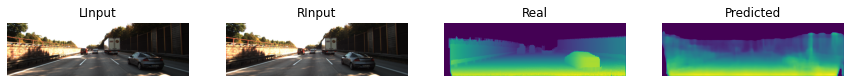

epoch: 284   loss: 0.19749614596366882
-------- psnr:  34.301563    ----- epoch:  284   count:  5


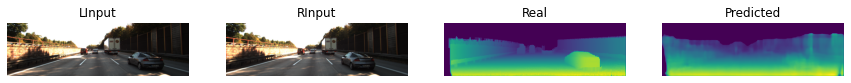

epoch: 285   loss: 0.2053389996290207
-------- psnr:  34.132744    ----- epoch:  285   count:  5


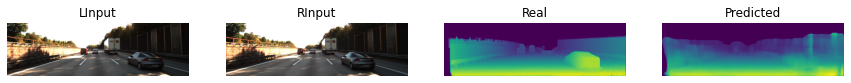

epoch: 286   loss: 0.198023721575737
-------- psnr:  34.021282    ----- epoch:  286   count:  5


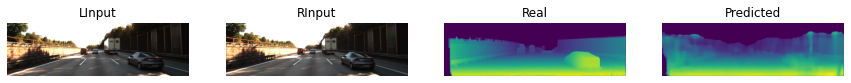

epoch: 287   loss: 0.19168642163276672
-------- psnr:  34.292164    ----- epoch:  287   count:  5


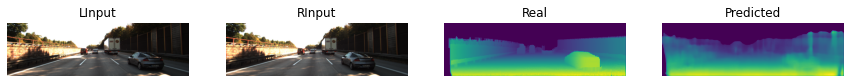

epoch: 288   loss: 0.18532776832580566
-------- psnr:  34.12736    ----- epoch:  288   count:  5


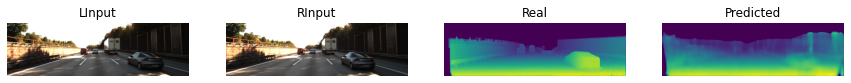

epoch: 289   loss: 0.18051671981811523
-------- psnr:  33.801357    ----- epoch:  289   count:  5


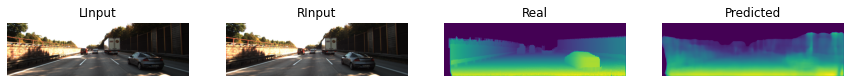

epoch: 290   loss: 0.18343868851661682
-------- psnr:  33.567566    ----- epoch:  290   count:  5


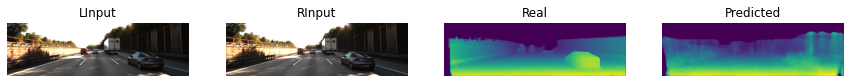

epoch: 291   loss: 0.18939447402954102
-------- psnr:  34.292053    ----- epoch:  291   count:  5


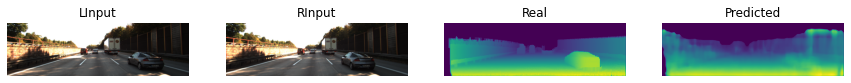

epoch: 292   loss: 0.18627238273620605
-------- psnr:  33.346428    ----- epoch:  292   count:  5


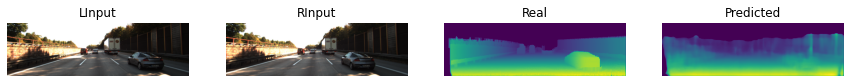

epoch: 293   loss: 0.19455046951770782
-------- psnr:  34.208675    ----- epoch:  293   count:  5


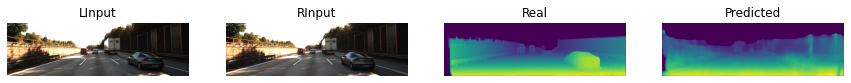

epoch: 294   loss: 0.18107202649116516
-------- psnr:  34.33436    ----- epoch:  294   count:  5


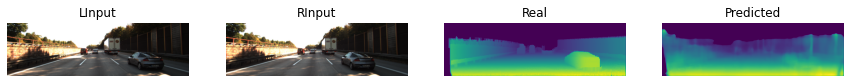

epoch: 295   loss: 0.17453184723854065
-------- psnr:  33.849556    ----- epoch:  295   count:  5


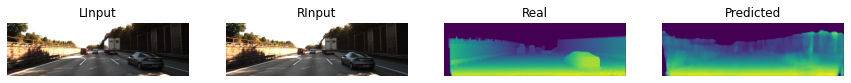

epoch: 296   loss: 0.17703218758106232
-------- psnr:  34.333797    ----- epoch:  296   count:  5


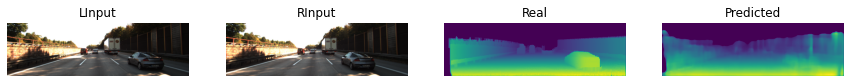

epoch: 297   loss: 0.18384452164173126
-------- psnr:  34.289497    ----- epoch:  297   count:  5


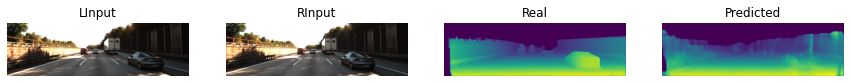

epoch: 298   loss: 0.17870424687862396
-------- psnr:  33.987366    ----- epoch:  298   count:  5


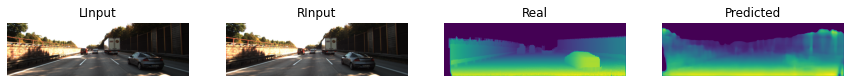

epoch: 299   loss: 0.16649030148983002
-------- psnr:  33.903404    ----- epoch:  299   count:  5


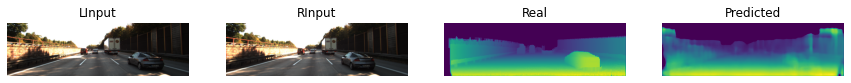

In [23]:
EPOCHS = 300
fit(train_dataset, EPOCHS, val_dataset)

In [24]:
res50Unet.save("Stereo/stereo_dense_stixel.h5")

## Evaluate Results

In [25]:
res50Unet = tf.keras.models.load_model("Stereo/stereo_dense_stixel.h5")


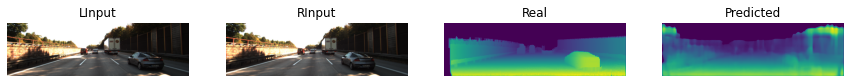

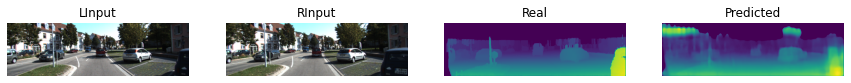

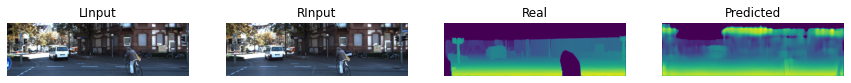

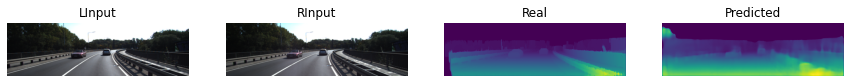

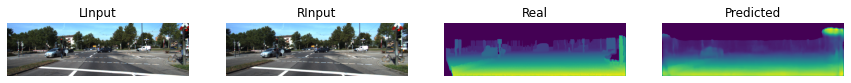

In [26]:
for idx in range(5):
    for l_inputs, r_inputs, targets in val_dataset.take(1):
        fake = res50Unet([l_inputs, r_inputs], training=True)
        plt.figure(figsize=(15,20))
        display_list = [l_inputs[idx], r_inputs[idx], targets[idx], fake[idx]]
    
    
        title = ['LInput', 'RInput', 'Real', 'Predicted']    

        for i in range(4):
            plt.subplot(1, 4, i+1)
            plt.title(title[i])
            plt.imshow(display_list[i])
            plt.axis('off')
        plt.show()       